In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import glob
import cv2
from google.colab.patches import cv2_imshow

IMAGE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo/*"


In [ ]:
image_paths = glob.glob(IMAGE_FOLDER)

print("Total images found:", len(image_paths))

images = []

for path in image_paths:
    img = cv2.imread(path)
    if img is not None:
        images.append(img)


Total images found: 2


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loading Class: Sub1
Loading Class: sub2

Dataset Loaded Successfully!
Total Images: 132
Classes: ['Sub1', 'sub2']


/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 62, 62, 32)     │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 31, 31, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 29, 29, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 14, 14, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 12544)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │     1,605,760 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 2)              │           258 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,625,410 (6.20 MB)

 Trainable params: 1,625,410 (6.20 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 2s 288ms/step - accuracy: 0.4613 - loss: 0.9605 - val_accuracy: 0.8571 - val_loss: 0.4294
Epoch 2/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 179ms/step - accuracy: 0.7440 - loss: 0.5284 - val_accuracy: 0.8571 - val_loss: 0.5511
Epoch 3/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 182ms/step - accuracy: 0.7362 - loss: 0.5537 - val_accuracy: 0.8571 - val_loss: 0.4635
Epoch 4/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 179ms/step - accuracy: 0.7089 - loss: 0.5173 - val_accuracy: 0.8571 - val_loss: 0.4081
Epoch 5/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 175ms/step - accuracy: 0.7284 - loss: 0.5227 - val_accuracy: 0.8571 - val_loss: 0.4137
Epoch 6/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 179ms/step - accuracy: 0.7539 - loss: 0.4672 - val_accuracy: 0.8571 - val_loss: 0.4273
Epoch 7/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 190ms/step - accuracy: 0.7656 - loss: 0.4219 - val_accuracy: 0.8571 - val_loss: 0.3872
Epoch 8/10
3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 174ms/step - accuracy: 0.7718 - loss: 0.3959 - val_accuracy: 0.8571 - val_loss:

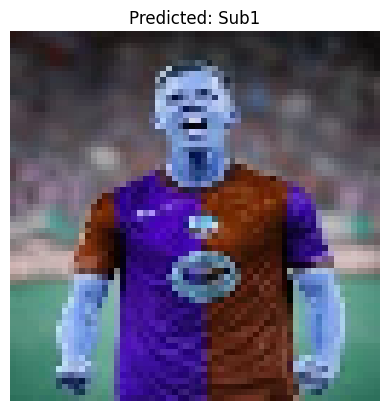

In [ ]:
# ======================================================
# 1. Mount Google Drive


#Google Drive mount
#✔ Dataset load from your photo/ folder
#✔ Auto-label creation from subfolder names
#✔ Train/Test split
#✔ Preprocessing
# CNN model
# Training
# Evaluation
# Sample prediction
# ======================================================
from google.colab import drive
drive.mount('/content/drive')

# ======================================================
# 2. Import Libraries
# ======================================================
import os
import cv2
import glob
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import img_to_array

# ======================================================
# 3. Dataset Path
# ======================================================
BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo"

# ======================================================
# 4. Load Images from Subfolders
# ======================================================
images = []
labels = []
class_names = []

# find subfolders (each subfolder = one class)
for idx, folder in enumerate(sorted(os.listdir(BASE_FOLDER))):
    folder_path = os.path.join(BASE_FOLDER, folder)

    if os.path.isdir(folder_path):
        print(f"Loading Class: {folder}")
        class_names.append(folder)

        for img_path in glob.glob(folder_path + "/*"):
            img = cv2.imread(img_path)
            if img is None:
                continue

            img = cv2.resize(img, (64, 64))
            img = img_to_array(img) / 255.0

            images.append(img)
            labels.append(idx)

# Convert to numpy
images = np.array(images)
labels = np.array(labels)

print("\nDataset Loaded Successfully!")
print("Total Images:", images.shape[0])
print("Classes:", class_names)

# ======================================================
# 5. Train/Test Split
# ======================================================
X_train, X_test, y_train, y_test = train_test_split(
    images, labels, test_size=0.2, random_state=42, stratify=labels
)

y_train = to_categorical(y_train, num_classes=len(class_names))
y_test = to_categorical(y_test, num_classes=len(class_names))

# ======================================================
# 6. Build CNN Model
# ======================================================
model = Sequential([
    Conv2D(32, (3,3), activation="relu", input_shape=(64, 64, 3)),
    MaxPooling2D(2,2),

    Conv2D(64, (3,3), activation="relu"),
    MaxPooling2D(2,2),

    Flatten(),
    Dense(128, activation="relu"),
    Dropout(0.3),
    Dense(len(class_names), activation="softmax")
])

model.compile(
    loss="categorical_crossentropy",
    optimizer="adam",
    metrics=["accuracy"]
)

model.summary()

# ======================================================
# 7. Train Model
# ======================================================
history = model.fit(
    X_train, y_train,
    validation_split=0.2,
    epochs=10,
    batch_size=32
)

# ======================================================
# 8. Evaluate Model
# ======================================================
loss, acc = model.evaluate(X_test, y_test)
print(f"\nTest Accuracy: {acc*100:.2f}%")

# ======================================================
# 9. Predict a Sample Image
# ======================================================
import matplotlib.pyplot as plt

sample = X_test[0]
sample_img = np.expand_dims(sample, axis=0)
pred = model.predict(sample_img)
pred_class = class_names[np.argmax(pred)]

plt.imshow(sample)
plt.title(f"Predicted: {pred_class}")
plt.axis("off")
plt.show()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Detected Classes: ['Sub1', 'sub2']
Loading Sub1: 100 images
Loading sub2: 32 images
Images Shape: (132, 128, 128, 3)
Labels Shape: (132,)


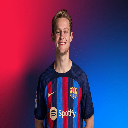

Train: (105, 128, 128, 3)
Val: (27, 128, 128, 3)


/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)               │ (None, 126, 126, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 63, 63, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 61, 61, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 30, 30, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 28, 28, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 14, 14, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 128)            │     3,211,392 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 2)              │           258 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 3,304,898 (12.61 MB)

 Trainable params: 3,304,898 (12.61 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 5s 872ms/step - accuracy: 0.6510 - loss: 0.9277 - val_accuracy: 0.7407 - val_loss: 0.6266
Epoch 2/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 7s 1s/step - accuracy: 0.7655 - loss: 0.6172 - val_accuracy: 0.7407 - val_loss: 0.5751
Epoch 3/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 3s 769ms/step - accuracy: 0.7516 - loss: 0.5554 - val_accuracy: 0.7407 - val_loss: 0.5771
Epoch 4/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 3s 760ms/step - accuracy: 0.7673 - loss: 0.5843 - val_accuracy: 0.7407 - val_loss: 0.5360
Epoch 5/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.7423 - loss: 0.5471 - val_accuracy: 0.7407 - val_loss: 0.5434
Epoch 6/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 4s 823ms/step - accuracy: 0.7798 - loss: 0.4811 - val_accuracy: 0.7407 - val_loss: 0.5477
Epoch 7/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 4s 785ms/step - accuracy: 0.7381 - loss: 0.5276 - val_accuracy: 0.7407 - val_loss: 0.5372
Epoch 8/10
4/4 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.8006 - loss: 0.4390 - val_accuracy: 0.7407 - val_loss: 0.5428
E

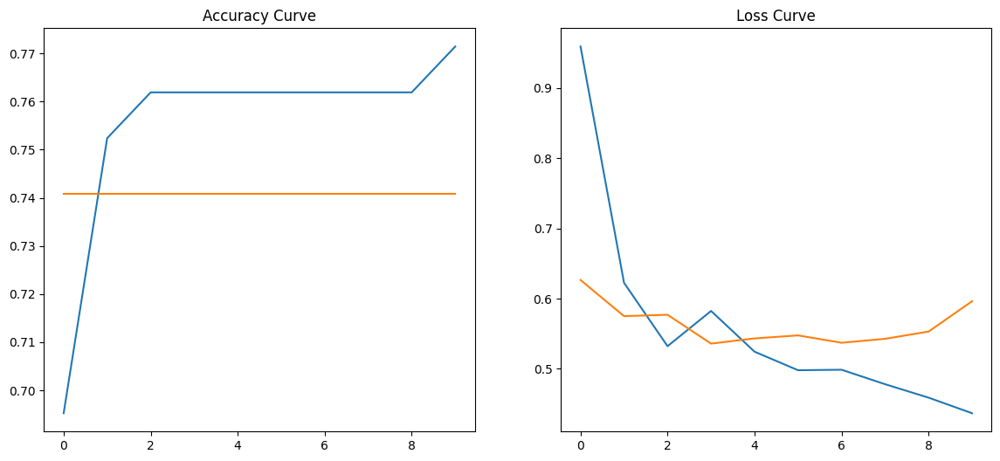

Model Saved!


Model Loaded Successfully!
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.1/100.1 MB 9.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566166 sha256=a02d16db563e6edbb294c1a7598ab0231dbf5157d6ca97759fc3606b16ce50ce
  Stored in directory: /root/.cache/pip/wheels/8f/47/c8/f44c5aebb7507f7c8a2c0bd23151d732d0f0bd6884ad4ac635
Successfully built face-recognition-models


RuntimeError: Error while calling cudaGetDevice(&the_device_id) in file /root/.cache/uv/sdists-v9/pypi/dlib/19.24.6/vstIK3uXibarXdZTBBqg_/src/dlib/cuda/gpu_data.cpp:204. code: 35, reason: CUDA driver version is insufficient for CUDA runtime version

In [ ]:
# =========================================================
# SMART CLASSROOM – FULL SYSTEM (ONE FILE)
# =========================================================

# =========================================================
# STEP 1 — Mount Google Drive
# =========================================================
from google.colab import drive
drive.mount('/content/drive')

# =========================================================
# STEP 2 — Load Dataset From Subfolders
# =========================================================
import glob, cv2, os
import numpy as np
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split

BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo"

classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])

images = []
labels = []

print("Detected Classes:", classes)

for label_idx, cls in enumerate(classes):
    cls_path = os.path.join(BASE_FOLDER, cls)
    paths = glob.glob(cls_path + "/*")

    print(f"Loading {cls}: {len(paths)} images")

    for p in paths:
        img = cv2.imread(p)
        if img is not None:
            img = cv2.resize(img, (128,128))
            images.append(img)
            labels.append(label_idx)

images = np.array(images, dtype="float32") / 255.0
labels = np.array(labels)

print("Images Shape:", images.shape)
print("Labels Shape:", labels.shape)

cv2_imshow((images[0] * 255).astype("uint8"))

# =========================================================
# STEP 3 — Train Test Split + One Hot Encoding
# =========================================================
from tensorflow.keras.utils import to_categorical

num_classes = len(classes)

X_train, X_val, y_train, y_val = train_test_split(
    images, labels, test_size=0.2, random_state=42, stratify=labels
)

y_train = to_categorical(y_train, num_classes)
y_val = to_categorical(y_val, num_classes)

print("Train:", X_train.shape)
print("Val:", X_val.shape)

# =========================================================
# STEP 4 — Build CNN Model
# =========================================================
import tensorflow as tf
from tensorflow.keras import layers, models

model = models.Sequential([
    layers.Conv2D(32, (3,3), activation='relu', input_shape=(128,128,3)),
    layers.MaxPooling2D(2,2),

    layers.Conv2D(64, (3,3), activation='relu'),
    layers.MaxPooling2D(2,2),

    layers.Conv2D(128, (3,3), activation='relu'),
    layers.MaxPooling2D(2,2),

    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.4),
    layers.Dense(num_classes, activation='softmax')
])

model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])
model.summary()

# =========================================================
# STEP 5 — Train Model
# =========================================================
history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=10,
    batch_size=32
)

# =========================================================
# STEP 6 — Evaluate
# =========================================================
val_loss, val_acc = model.evaluate(X_val, y_val)
print("Validation Accuracy:", val_acc)

# =========================================================
# STEP 7 — Accuracy & Loss Graph
# =========================================================
import matplotlib.pyplot as plt

plt.figure(figsize=(14,6))

plt.subplot(1,2,1)
plt.plot(history.history["accuracy"])
plt.plot(history.history["val_accuracy"])
plt.title("Accuracy Curve")

plt.subplot(1,2,2)
plt.plot(history.history["loss"])
plt.plot(history.history["val_loss"])
plt.title("Loss Curve")

plt.show()

# =========================================================
# STEP 8 — Save & Load Model
# =========================================================
MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"
model.save(MODEL_PATH)
print("Model Saved!")

from tensorflow.keras.models import load_model
loaded_model = load_model(MODEL_PATH)
print("Model Loaded Successfully!")

# =========================================================
# STEP 9 — Predict Single Image
# =========================================================
def predict_single_image(img_path):
    img = cv2.imread(img_path)
    img = cv2.resize(img, (128,128))
    img_norm = img.astype("float32") / 255.0
    img_input = np.expand_dims(img_norm, axis=0)

    pred = loaded_model.predict(img_input)
    class_id = np.argmax(pred)

    print("Predicted:", classes[class_id])
    cv2_imshow(img)
    return classes[class_id]

# =========================================================
# STEP 10 — Predict Full Folder
# =========================================================
def predict_full_folder(folder):
    paths = glob.glob(folder + "/*")
    for img in paths:
        try:
            predict_single_image(img)
        except:
            print("Skipped:", img)

# =========================================================
# STEP 11 — Real-time Webcam Detection (COLAB VERSION)
# =========================================================
from IPython.display import display, Javascript
from google.colab.output import eval_js
import base64

def get_webcam_frame():
    js = Javascript('''
      async function captureImage() {
        const video = document.createElement('video');
        const canvas = document.createElement('canvas');
        const ctx = canvas.getContext('2d');

        const stream = await navigator.mediaDevices.getUserMedia({video: true});
        video.srcObject = stream;
        await video.play();

        await new Promise(resolve => setTimeout(resolve, 500));

        canvas.width = video.videoWidth;
        canvas.height = video.videoHeight;

        ctx.drawImage(video, 0, 0);

        stream.getTracks()[0].stop();
        return canvas.toDataURL('image/jpeg', 0.8);
      }
      captureImage();
    ''')

    data = eval_js(js)
    img_bytes = base64.b64decode(data.split(',')[1])
    img_array = np.frombuffer(img_bytes, np.uint8)
    img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
    return img

def webcam_predict():
    img = get_webcam_frame()
    show = img.copy()

    img = cv2.resize(img, (128,128))
    img = img.astype("float32") / 255.0
    img = np.expand_dims(img, axis=0)

    pred = loaded_model.predict(img)
    class_id = np.argmax(pred)

    print("Webcam Prediction:", classes[class_id])
    cv2_imshow(show)

# webcam_predict()

# =========================================================
# STEP 12 — FACE RECOGNITION + CNN CLASSIFICATION
# =========================================================
!pip install face_recognition
import face_recognition

known_encodings = []
known_names = []

KNOWN_FACE_DIR = "/content/drive/MyDrive/known_faces"

for person in os.listdir(KNOWN_FACE_DIR):
    p_path = os.path.join(KNOWN_FACE_DIR, person)
    for img in os.listdir(p_path):
        img_path = os.path.join(p_path, img)
        img_file = face_recognition.load_image_file(img_path)
        enc = face_recognition.face_encodings(img_file)

        if len(enc) > 0:
            known_encodings.append(enc[0])
            known_names.append(person)

print("Loaded Known Faces:", known_names)

def face_recognition_predict():
    frame = get_webcam_frame()
    rgb = frame[:, :, ::-1]

    boxes = face_recognition.face_locations(rgb)
    encs = face_recognition.face_encodings(rgb, boxes)

    for (top, right, bottom, left), enc in zip(boxes, encs):
        matches = face_recognition.compare_faces(known_encodings, enc)
        name = "Unknown"

        if True in matches:
            name = known_names[matches.index(True)]

        face_crop = frame[top:bottom, left:right]

        try:
            img = cv2.resize(face_crop, (128,128))
            img = img.astype("float32") / 255.0
            img = np.expand_dims(img, axis=0)

            pred = loaded_model.predict(img)
            class_id = np.argmax(pred)
            class_name = classes[class_id]
        except:
            class_name = "N/A"

        print(f"Face: {name} | CNN: {class_name}")

    cv2_imshow(frame)

# face_recognition_predict()

# =========================================================
# END OF SINGLE FILE
# =========================================================


In [ ]:
# =================== Required imports & model load ===================
import os
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import load_model

# MODEL_PATH —
MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"

try:
    classes  # noqa: F821
except NameError:
    BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo"
    classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])
    print("Classes loaded from BASE_FOLDER:", classes)

# loaded_model, load or check
if 'loaded_model' not in globals():
    if os.path.exists(MODEL_PATH):
        loaded_model = load_model(MODEL_PATH)
        print("Loaded model from:", MODEL_PATH)
    else:
        raise FileNotFoundError(f"Model file not found at {MODEL_PATH}. 먼저 model save/put করুন।")

# =================== Predict function ===================
def predict_single_image_with_accuracy(img_path):
    # path check
    if not os.path.exists(img_path):
        print("Image not found:", img_path)
        return None, None

    # read
    img = cv2.imread(img_path)
    if img is None:
        print("Unable to read image (cv2 returned None):", img_path)
        return None, None

    # prepare for CNN
    img_resized = cv2.resize(img, (128,128))
    img_norm = img_resized.astype("float32") / 255.0
    img_input = np.expand_dims(img_norm, axis=0)

    # predict
    preds = loaded_model.predict(img_input)[0]
    class_id = int(np.argmax(preds))
    class_name = classes[class_id] if class_id < len(classes) else f"Class_{class_id}"
    confidence = float(preds[class_id]) * 100.0

    # show and print
    cv2_imshow(img)   # Colab-friendly display
    print(f"Predicted Class: {class_name}")
    print(f"accuracy: {confidence:.2f}%")

    return class_name, confidence

# =================== Call the function ===================
img_path = "/content/drive/MyDrive/Colab Notebooks/photo2/class1/2.jpg"
predict_single_image_with_accuracy(img_path)


In [ ]:
!pip install face_recognition

import cv2
import numpy as np
import face_recognition
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

# ======================
# Prediction Function
# ======================
def predict_face_accuracy(face_img):
    """Predict class + accuracy from a face image"""
    try:
        img = cv2.resize(face_img, (128,128))
        img_norm = img.astype("float32") / 255.0
        img_input = np.expand_dims(img_norm, axis=0)

        preds = loaded_model.predict(img_input)[0]
        class_id = np.argmax(preds)
        class_name = classes[class_id]
        confidence = preds[class_id] * 100

        return class_name, confidence
    except:
        return "N/A", 0.0

# ======================
# Video Analysis
# ======================
def analyze_video_faces(video_path, frame_skip=1):
    cap = cv2.VideoCapture(video_path)
    if not cap.isOpened():
        print("Video not found or unable to open.")
        return

    frame_no = 0
    all_confidences = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        frame_no += 1
        if frame_no % frame_skip != 0:
            continue  # skip frames to speed up

        rgb = frame[:, :, ::-1]  # BGR → RGB
        boxes = face_recognition.face_locations(rgb)
        encodings = face_recognition.face_encodings(rgb, boxes)

        for (top, right, bottom, left), enc in zip(boxes, encodings):
            face_crop = frame[top:bottom, left:right]
            class_name, confidence = predict_face_accuracy(face_crop)
            all_confidences.append(confidence)

            # Overlay on frame
            cv2.rectangle(frame, (left, top), (right, bottom), (0,255,0), 2)
            text = f"{class_name} ({confidence:.1f}%)"
            cv2.putText(frame, text, (left, top-10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)

        cv2_imshow(frame)

    cap.release()
    print("Video analysis completed.")

    # Accuracy plot
    plt.figure(figsize=(12,4))
    plt.plot(all_confidences, marker='o')
    plt.title("Face Prediction Confidence Over Time")
    plt.xlabel("Detected Face #")
    plt.ylabel("Confidence (%)")
    plt.grid(True)
    plt.show()

# ======================
# RUN ANALYSIS
# ======================
analyze_video_faces("/content/drive/MyDrive/Colab Notebooks/photo2/video/Barcelona.mp4", frame_skip=2)


In [ ]:
# =========================================================
# SMART CLASSROOM — VIDEO FACE DETECTION + CNN PREDICTION (CPU-ONLY)
# =========================================================

# STEP 1 — Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# STEP 2 — Import Libraries
import cv2
import numpy as np
import os
import glob
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import load_model

# STEP 3 — Load Classes & CNN Model
BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo2"
classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])
MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"
loaded_model = load_model(MODEL_PATH)
print("Classes:", classes)
print("Model Loaded Successfully!")

# STEP 4 — Predict Single Image + Accuracy
def predict_single_image_with_accuracy(img):
    img_resized = cv2.resize(img, (128,128))
    img_norm = img_resized.astype("float32") / 255.0
    img_input = np.expand_dims(img_norm, axis=0)
    preds = loaded_model.predict(img_input)[0]
    class_id = np.argmax(preds)
    class_name = classes[class_id]
    confidence = preds[class_id] * 100
    return class_name, confidence

# STEP 5 — Load Haar Cascade for Face Detection
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# STEP 6 — Analyze Video
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    frame_count = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5)

        for (x, y, w, h) in faces:
            face_crop = frame[y:y+h, x:x+w]
            try:
                class_name, confidence = predict_single_image_with_accuracy(face_crop)
            except:
                class_name, confidence = "N/A", 0

            # Draw rectangle & labels
            cv2.rectangle(frame, (x,y), (x+w, y+h), (0,255,0), 2)
            cv2.putText(frame, f"{class_name} ({confidence:.1f}%)",
                        (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)

        cv2_imshow(frame)
        frame_count += 1
        # break after first frame in Colab to avoid freezing
        if frame_count == 1:
            break

    cap.release()
    cv2.destroyAllWindows()

# STEP 7 — Run on Video
analyze_video("/content/drive/MyDrive/Colab Notebooks/photo2/video/Barcelona.mp4")


In [ ]:
# =========================================================
# SMART CLASSROOM — VIDEO FACE DETECTION + CNN PREDICTION + ACCURACY GRAPH (CPU-ONLY)
# =========================================================

# STEP 1 — Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# STEP 2 — Import Libraries
import cv2
import numpy as np
import os
import glob
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# STEP 3 — Load Classes & CNN Model
BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo2"
classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])
MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"
loaded_model = load_model(MODEL_PATH)
print("Classes:", classes)
print("Model Loaded Successfully!")

# STEP 4 — Predict Single Image + Accuracy
def predict_single_image_with_accuracy(img):
    img_resized = cv2.resize(img, (128,128))
    img_norm = img_resized.astype("float32") / 255.0
    img_input = np.expand_dims(img_norm, axis=0)
    preds = loaded_model.predict(img_input)[0]
    class_id = np.argmax(preds)
    class_name = classes[class_id]
    confidence = preds[class_id] * 100
    return class_name, confidence

# STEP 5 — Load Haar Cascade for Face Detection
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# STEP 6 — Analyze Video + Track Accuracy
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    frame_count = 0
    all_confidences = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5)

        for (x, y, w, h) in faces:
            face_crop = frame[y:y+h, x:x+w]
            try:
                class_name, confidence = predict_single_image_with_accuracy(face_crop)
            except:
                class_name, confidence = "N/A", 0

            all_confidences.append(confidence)

            # Draw rectangle & labels
            cv2.rectangle(frame, (x,y), (x+w, y+h), (0,255,0), 2)
            cv2.putText(frame, f"{class_name} ({confidence:.1f}%)",
                        (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)

        cv2_imshow(frame)
        frame_count += 1

        # break after first 50 frames in Colab to avoid freezing
        if frame_count >= 50:
            break

    cap.release()
    cv2.destroyAllWindows()

    # STEP 7 — Plot Accuracy over Frames
    if all_confidences:
        plt.figure(figsize=(12,6))
        plt.plot(all_confidences, marker='o')
        plt.title("CNN Prediction Confidence (%) over Frames")
        plt.xlabel("Frame Number")
        plt.ylabel("Confidence (%)")
        plt.grid(True)
        plt.show()
    else:
        print("No faces detected in video.")

# STEP 8 — Run on Video
VIDEO_PATH = "/content/drive/MyDrive/Colab Notebooks/photo2/video/Barcelona.mp4"
analyze_video(VIDEO_PATH)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Classes: ['class1', 'class2', 'video']
Model Loaded Successfully!


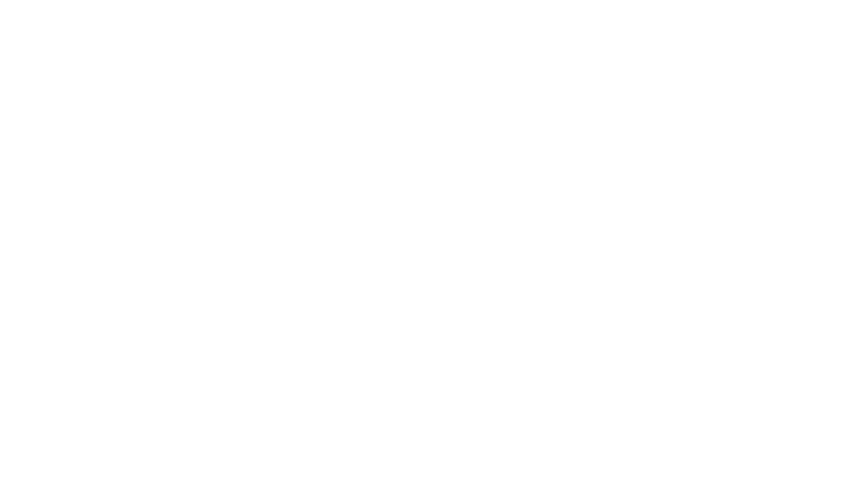

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


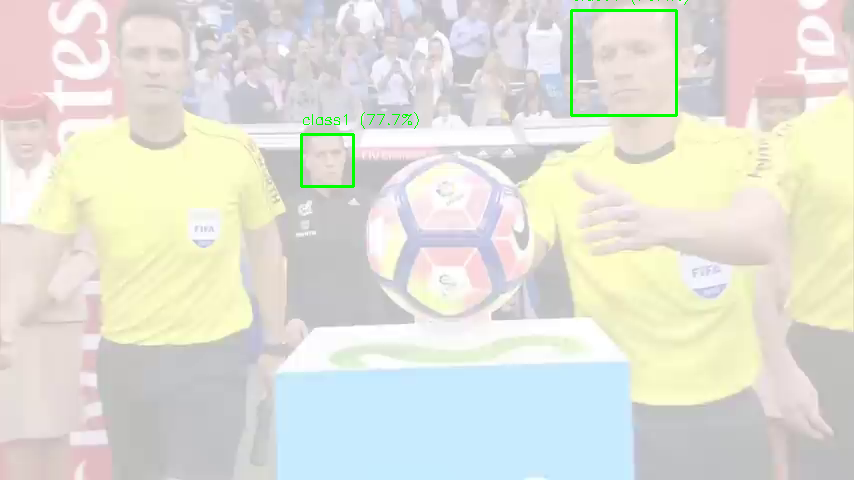

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


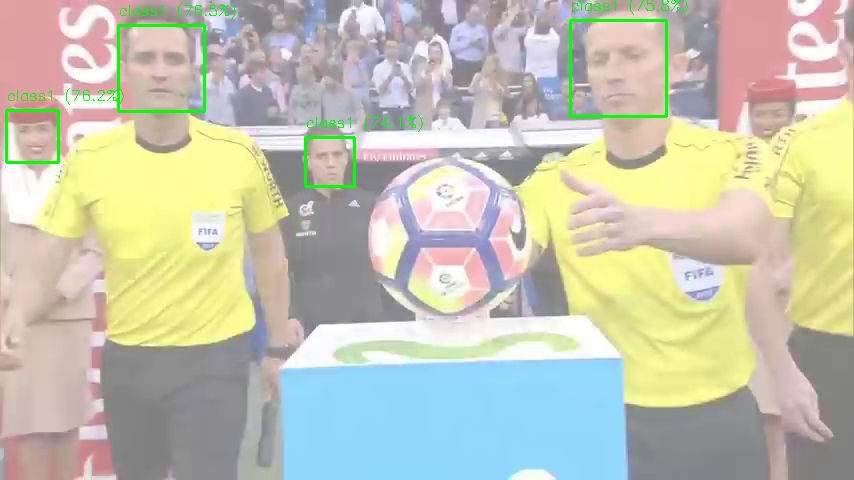

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


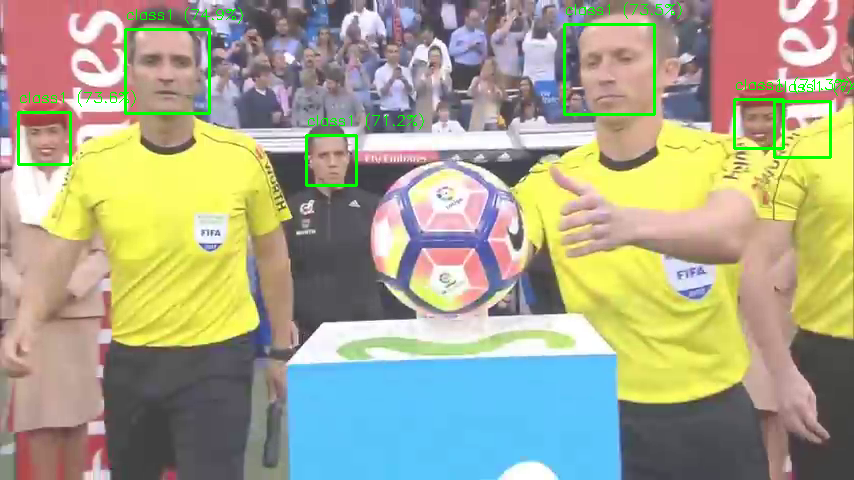

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step


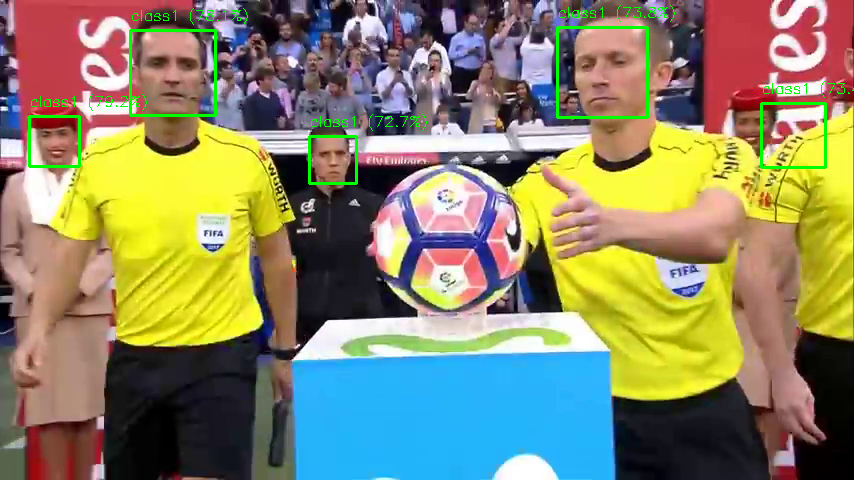

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


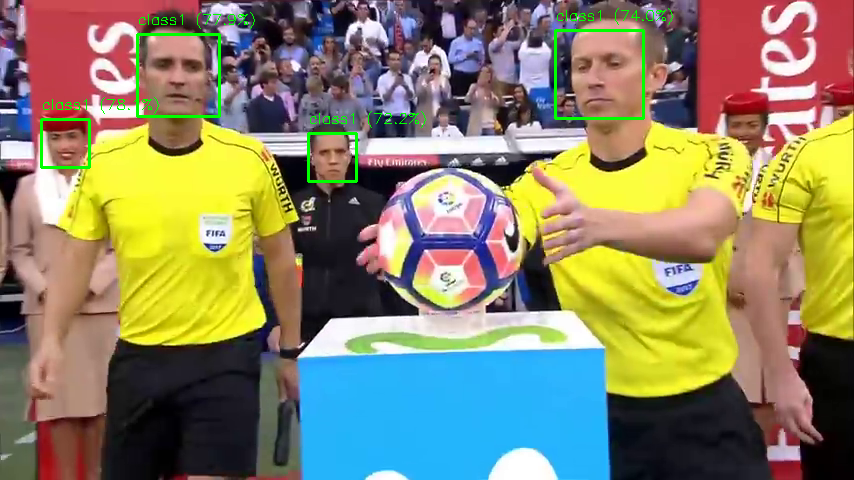

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


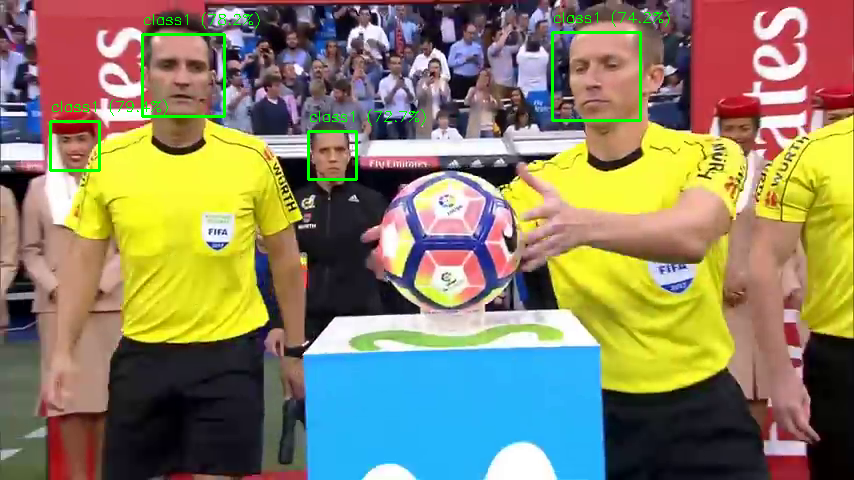

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


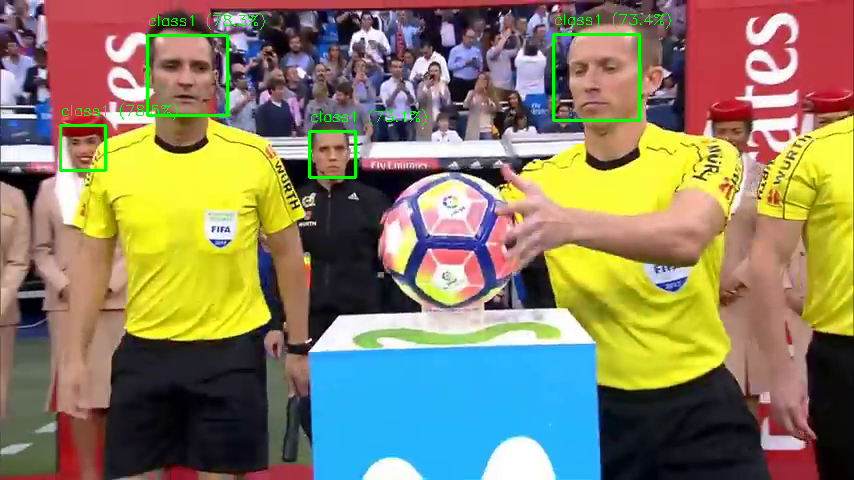

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


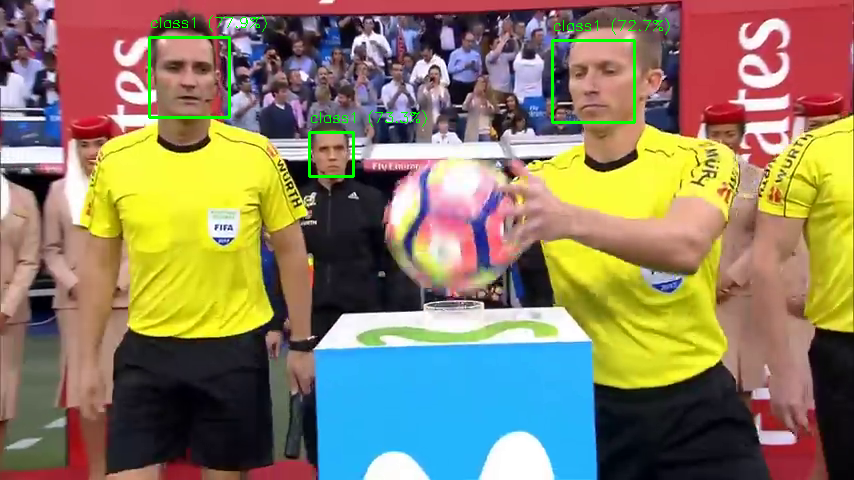

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


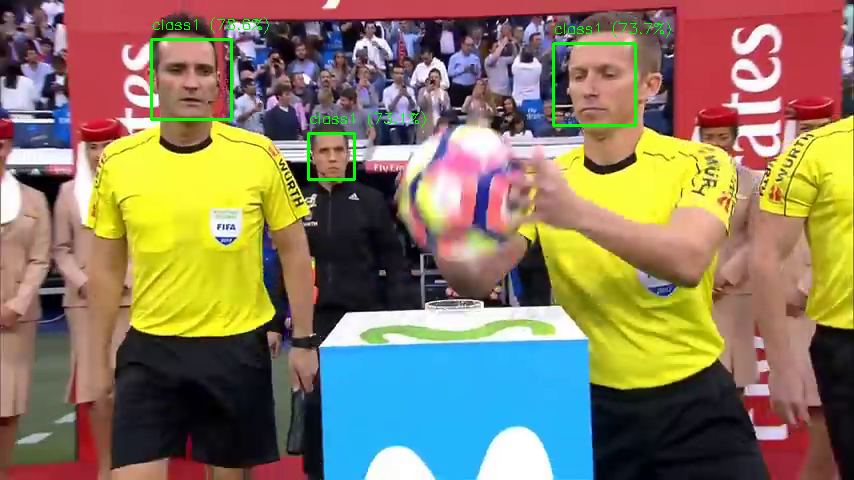

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


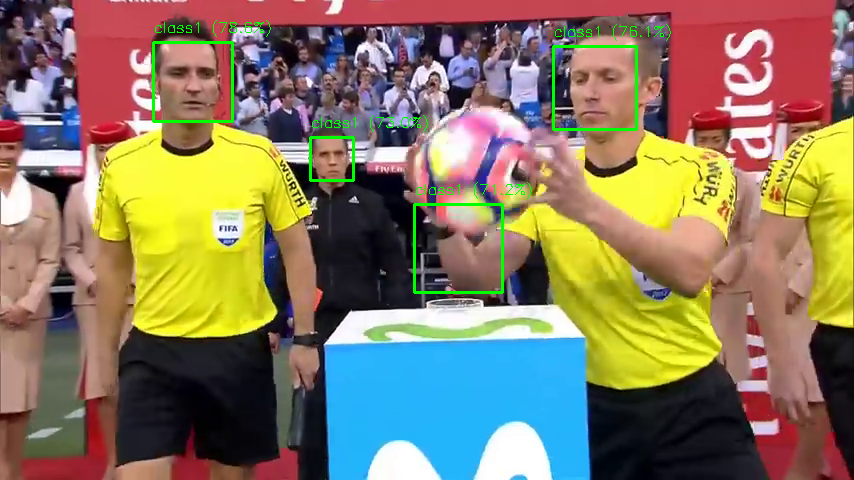

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


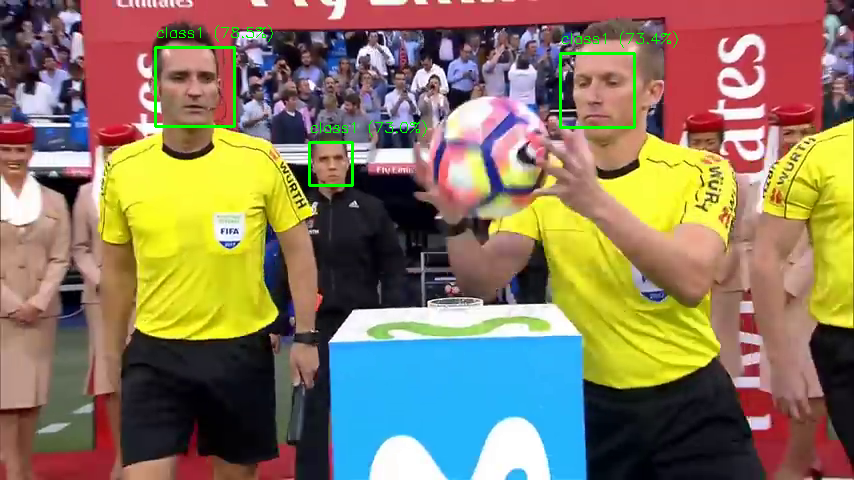

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step


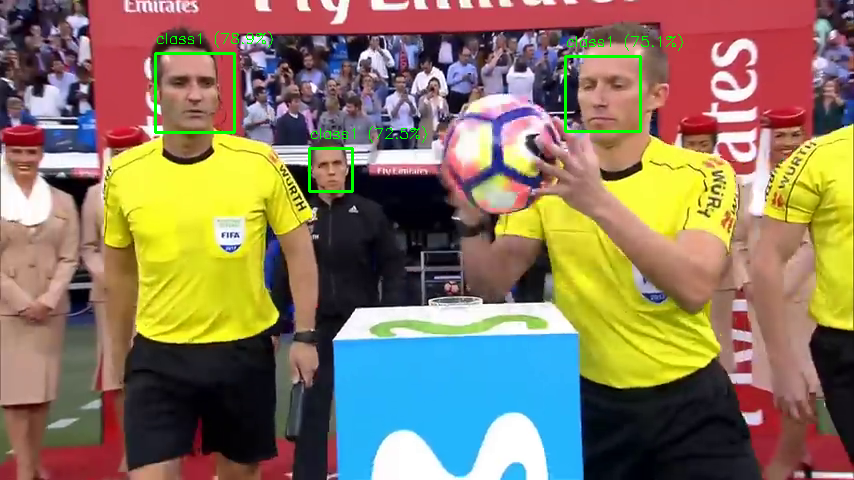

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


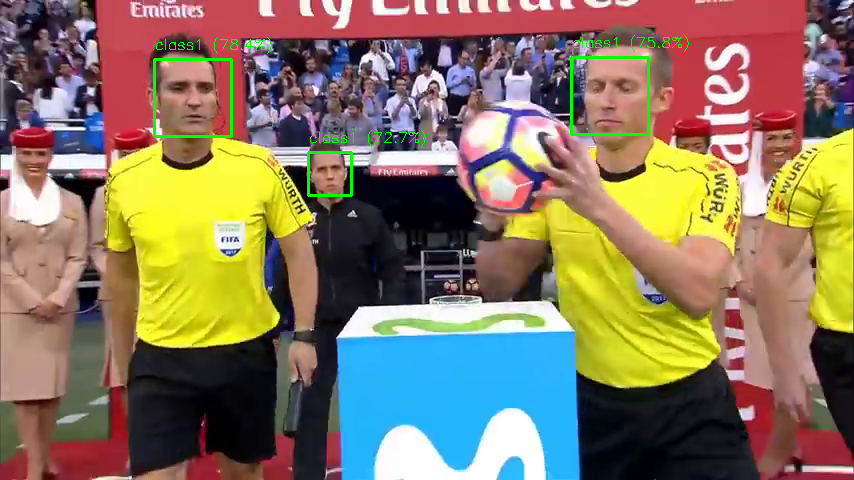

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


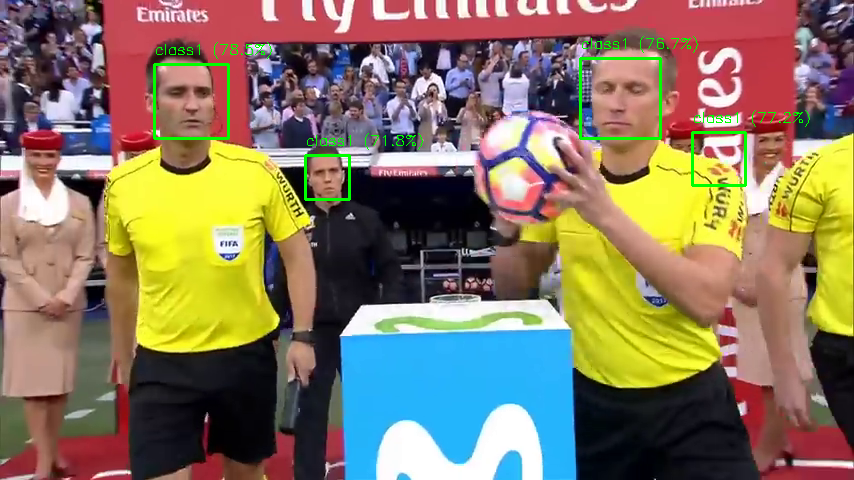

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step


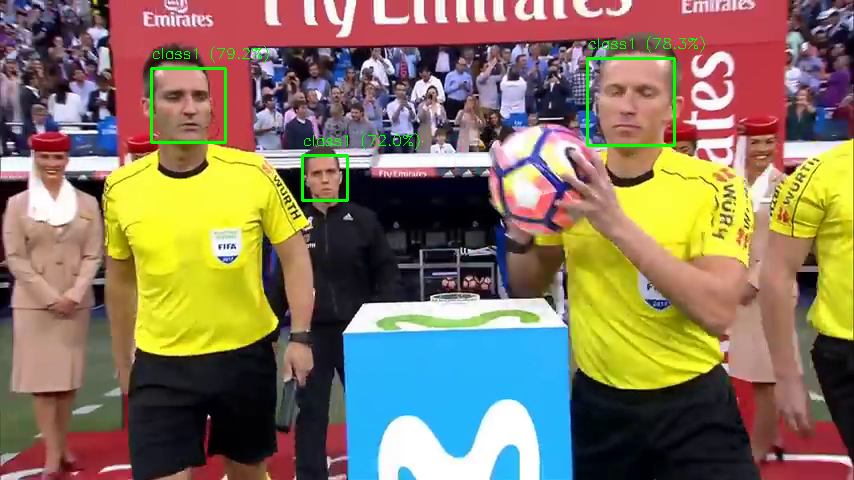

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


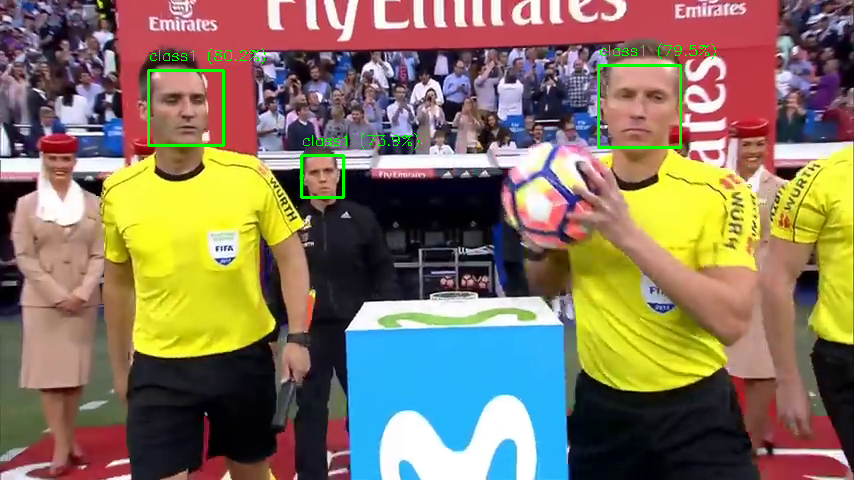

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step


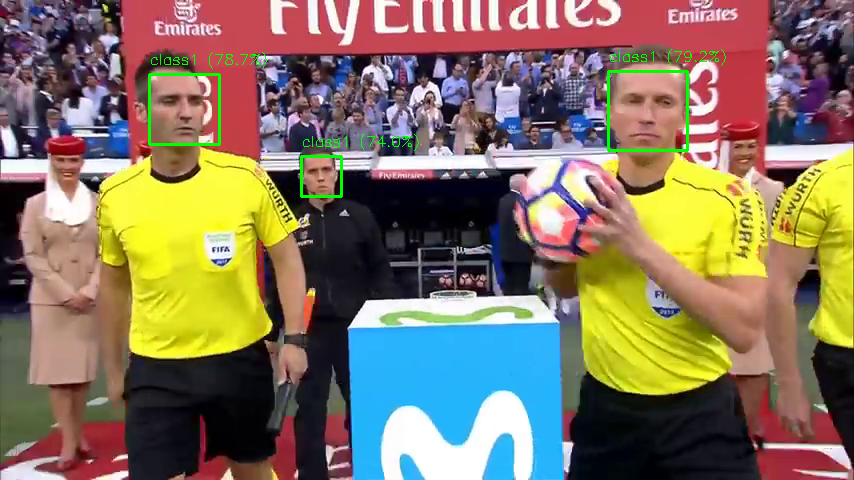

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


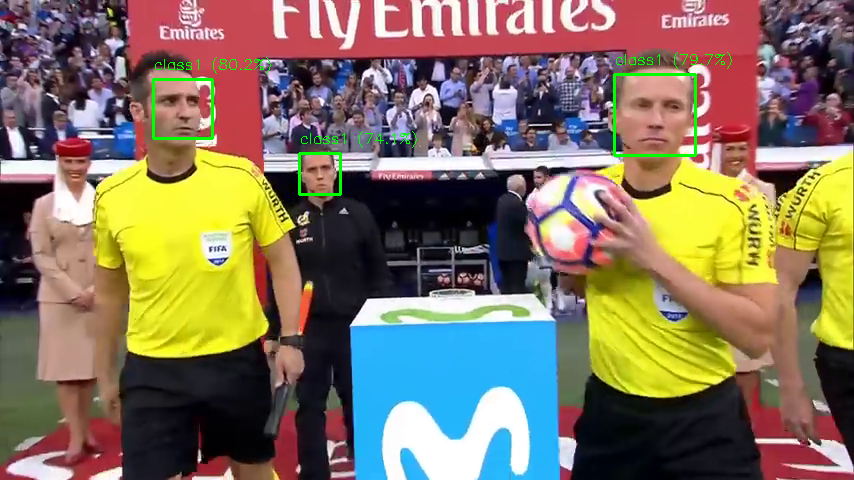

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


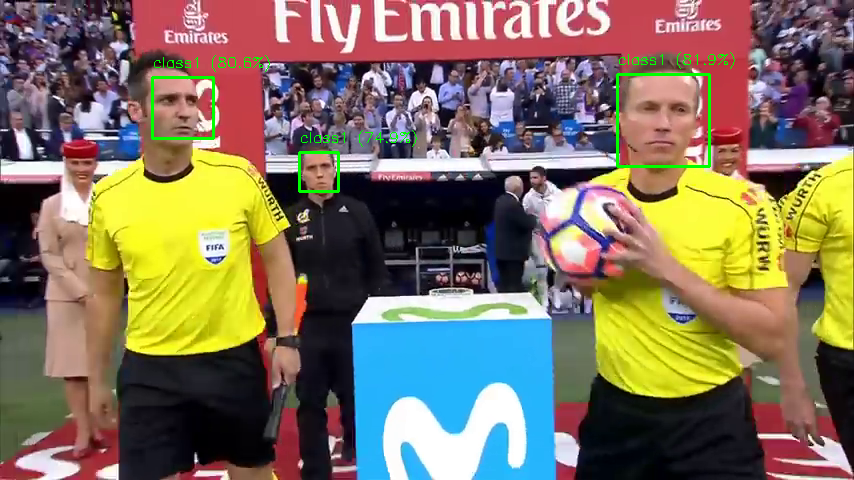

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


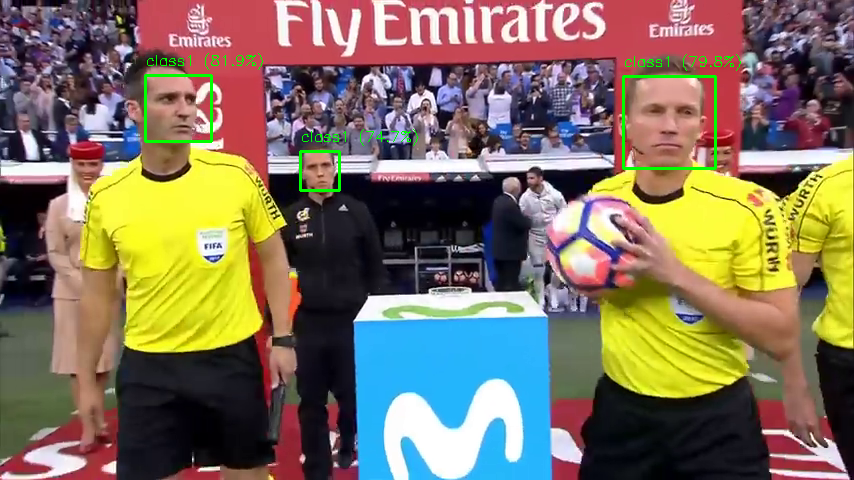

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


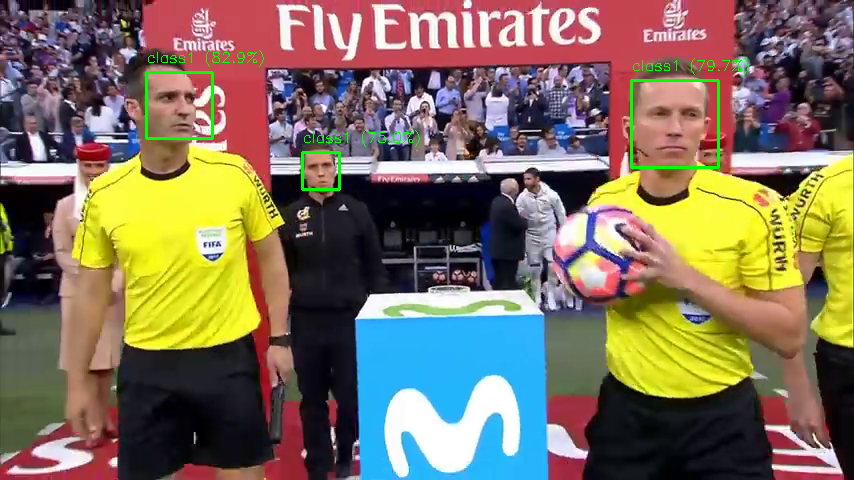

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


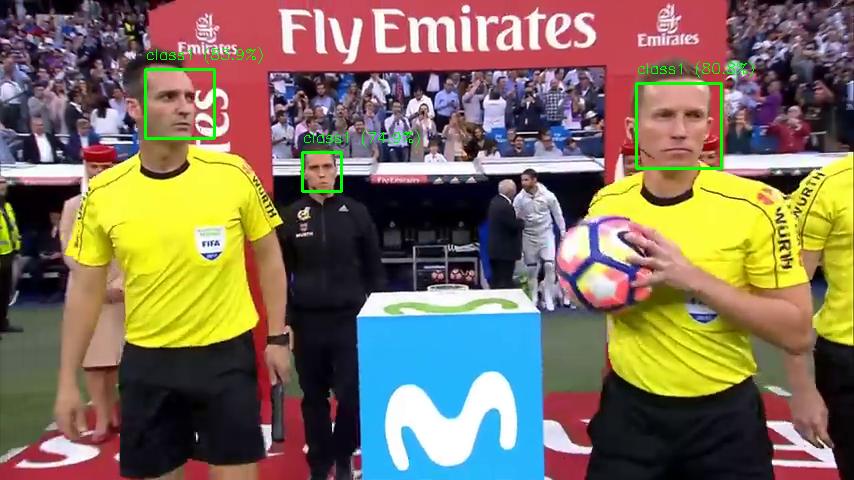

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


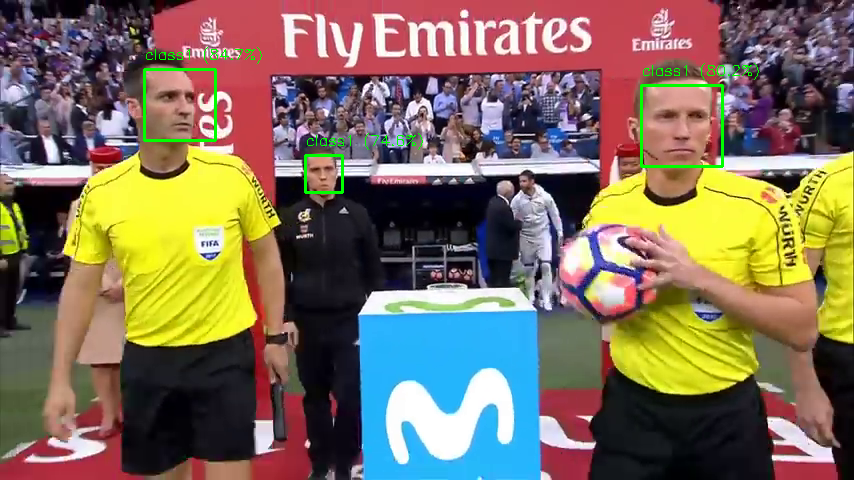

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


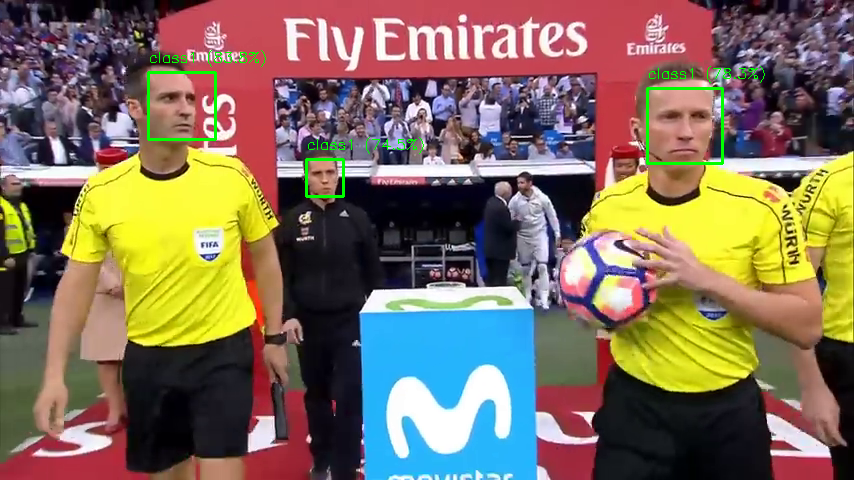

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


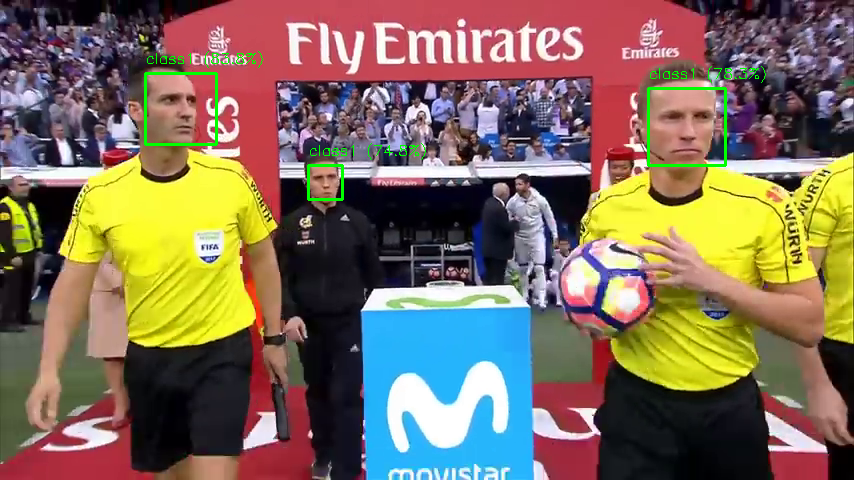

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


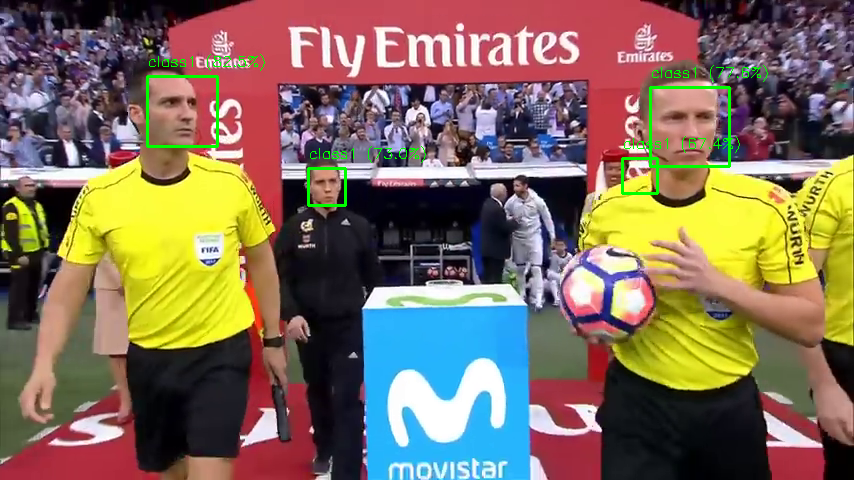

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


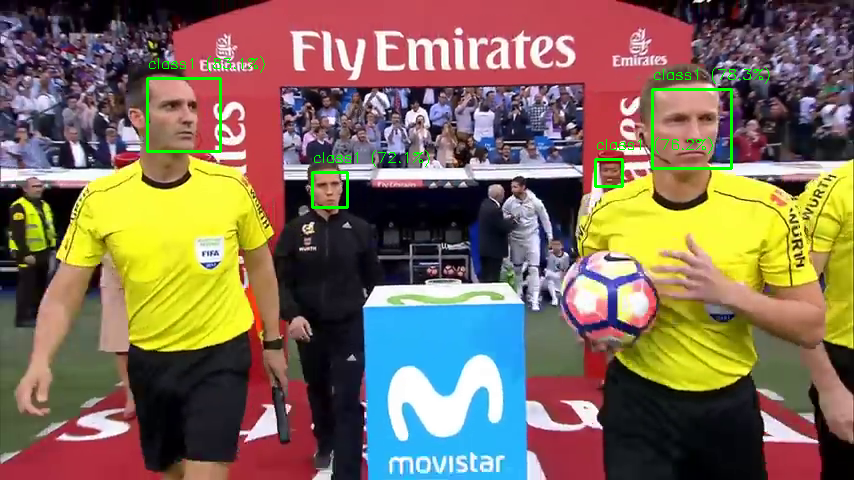

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step


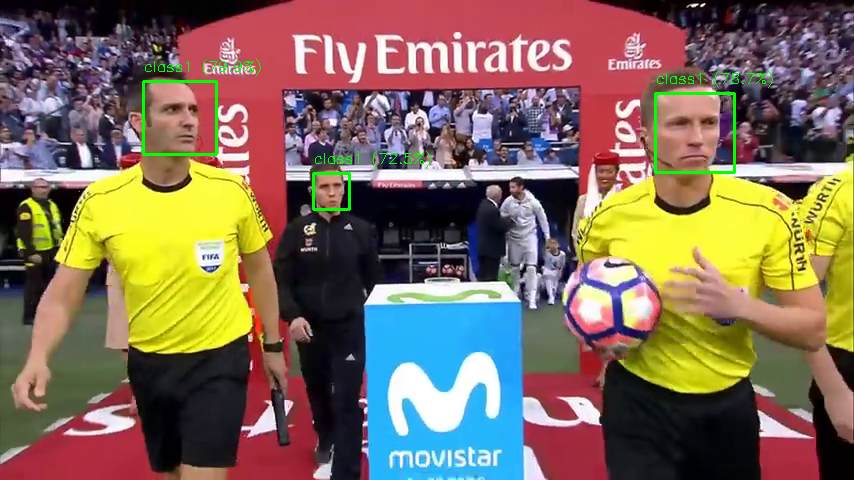

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


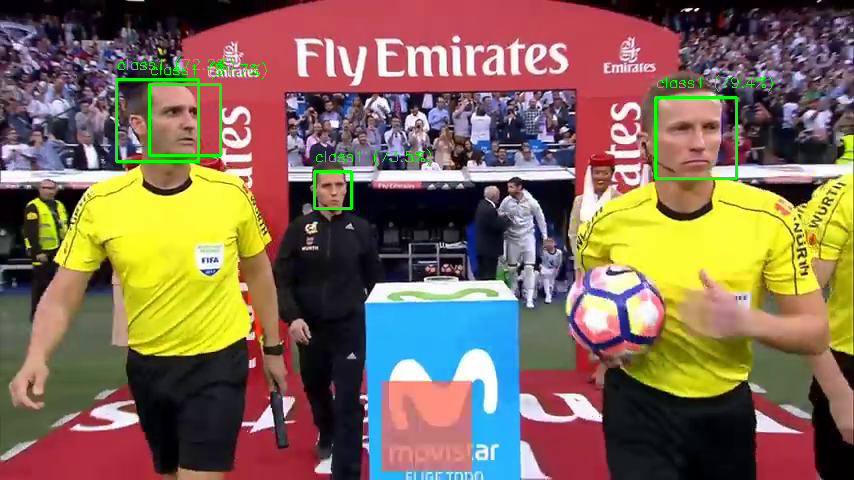

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


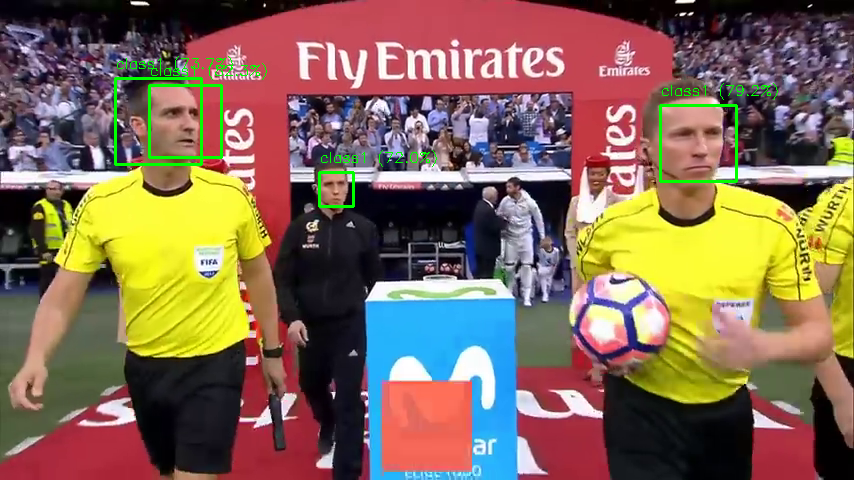

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


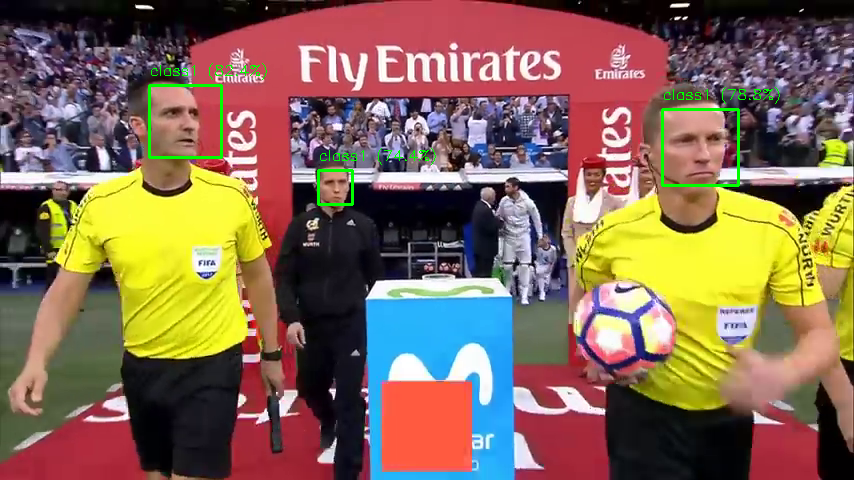

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


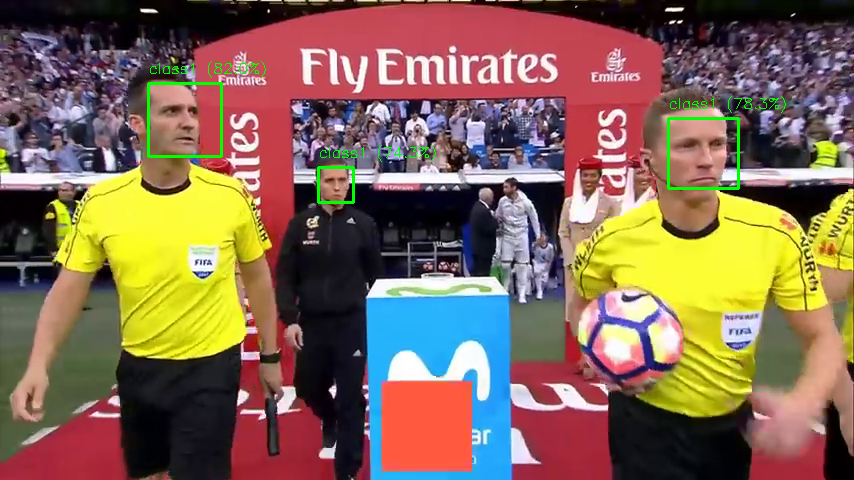

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


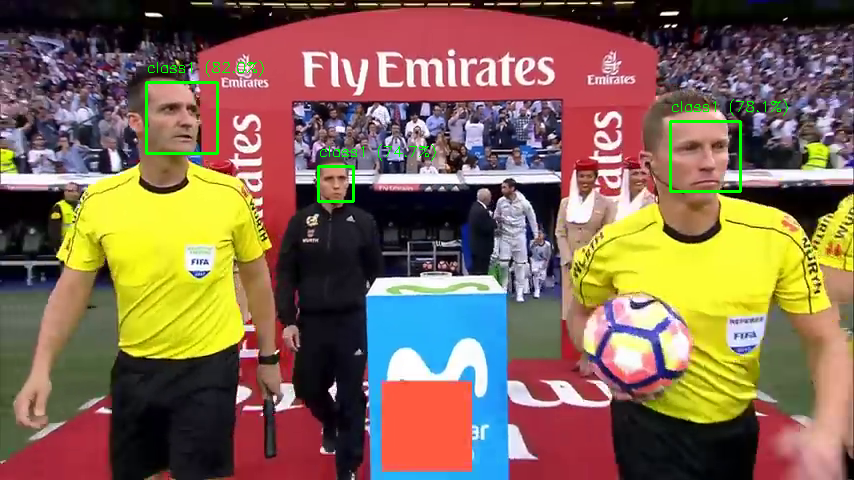

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


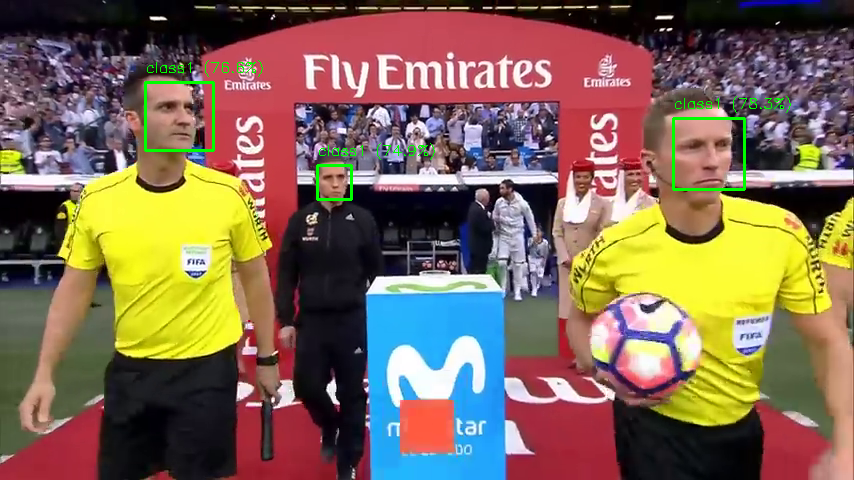

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


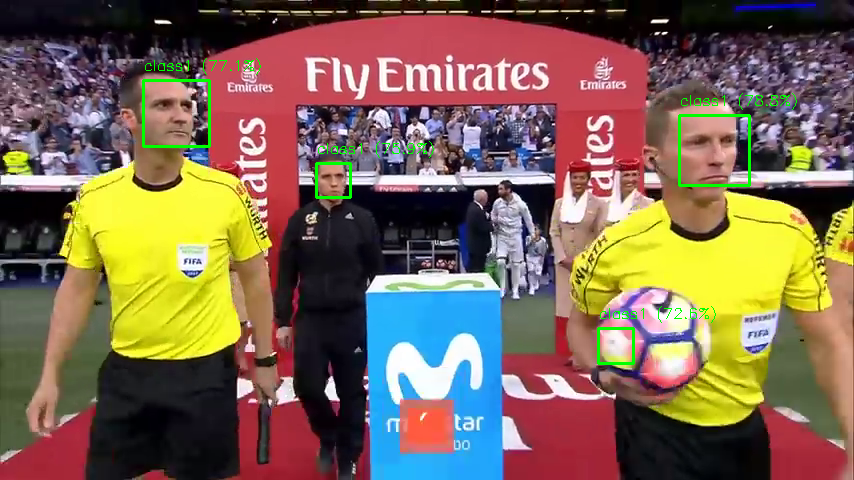

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


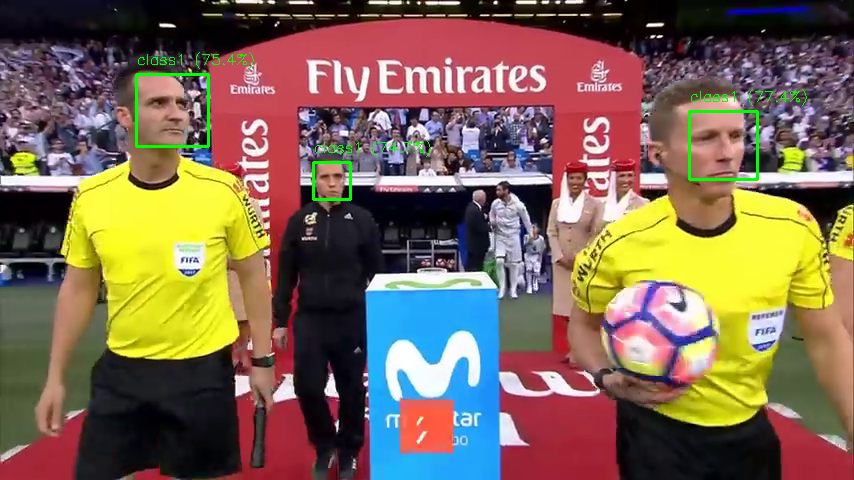

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


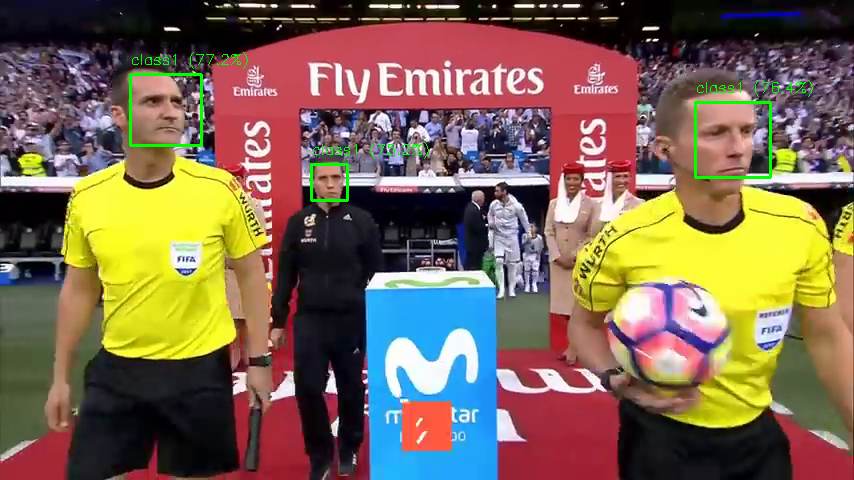

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


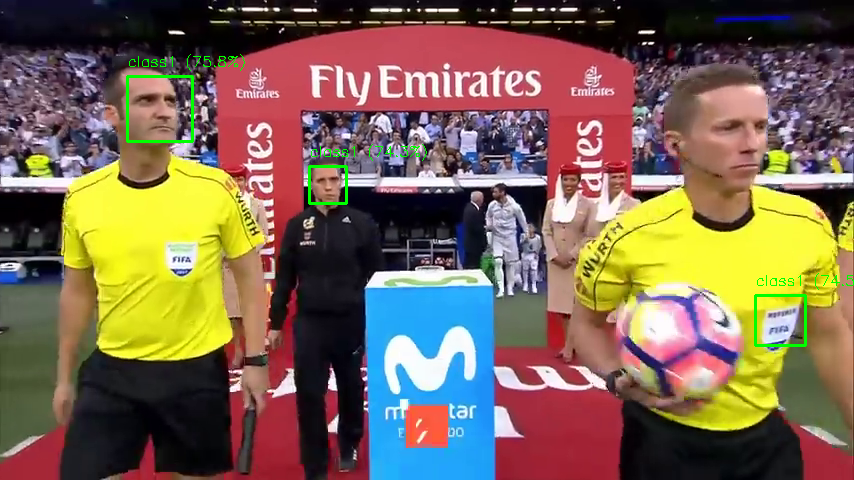

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


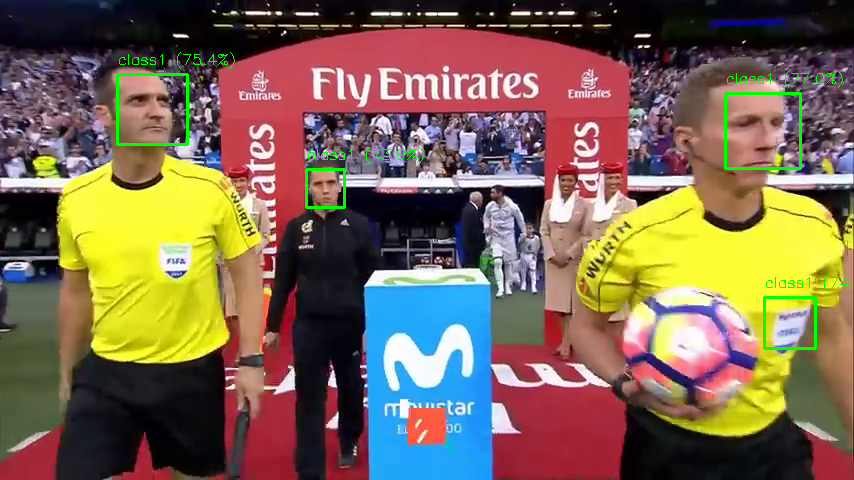

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


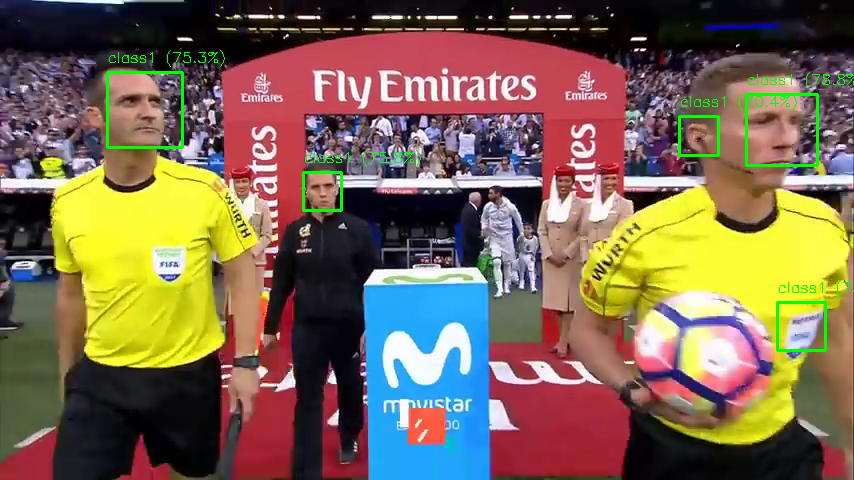

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


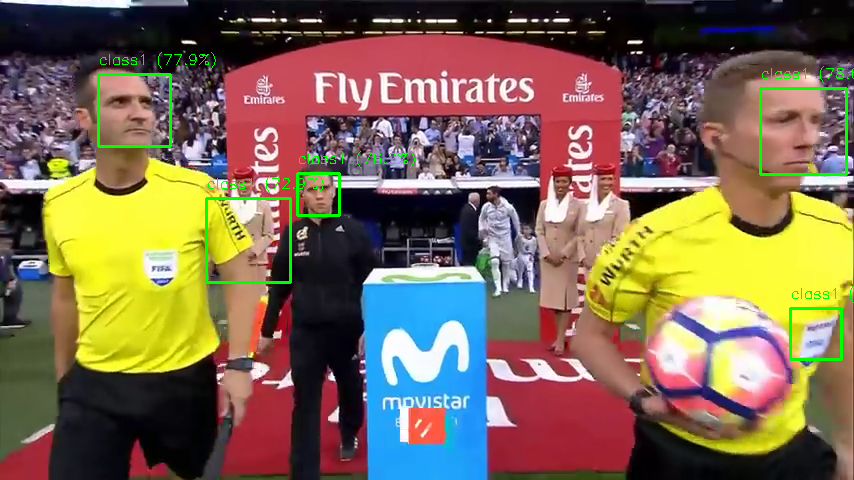

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


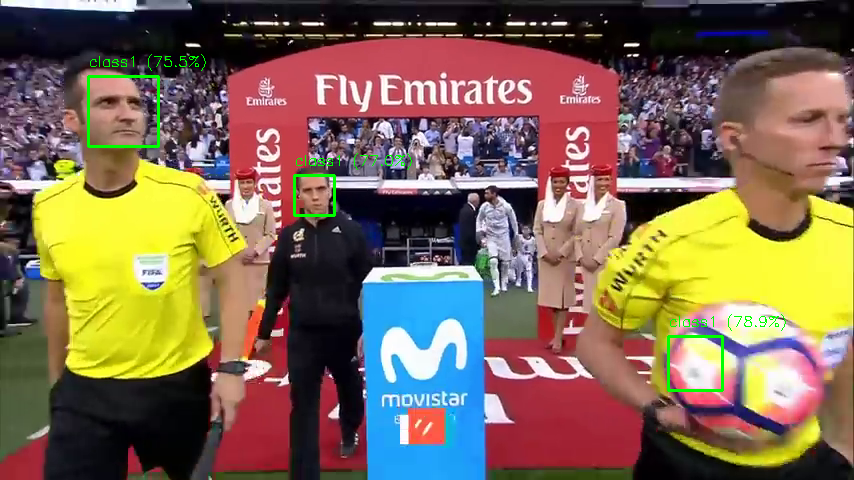

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step


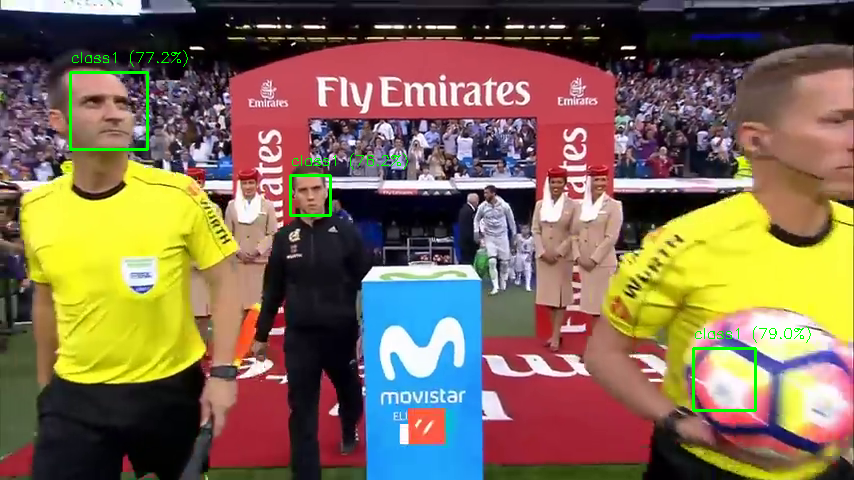

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step


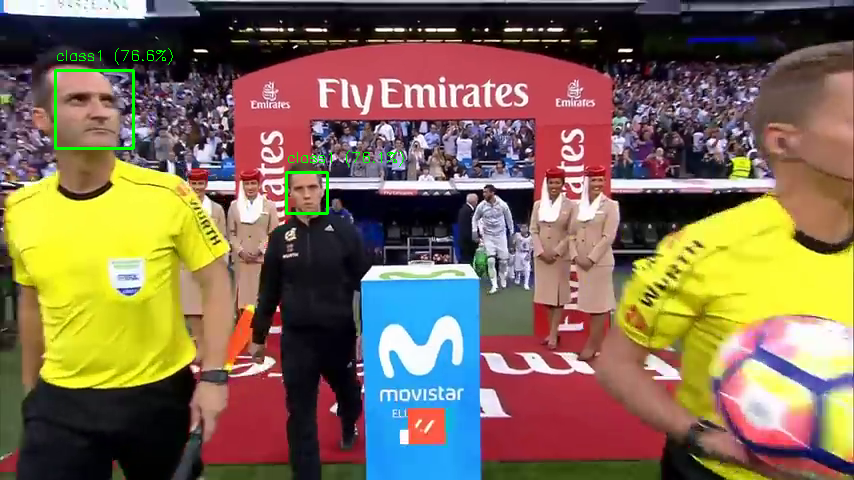

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


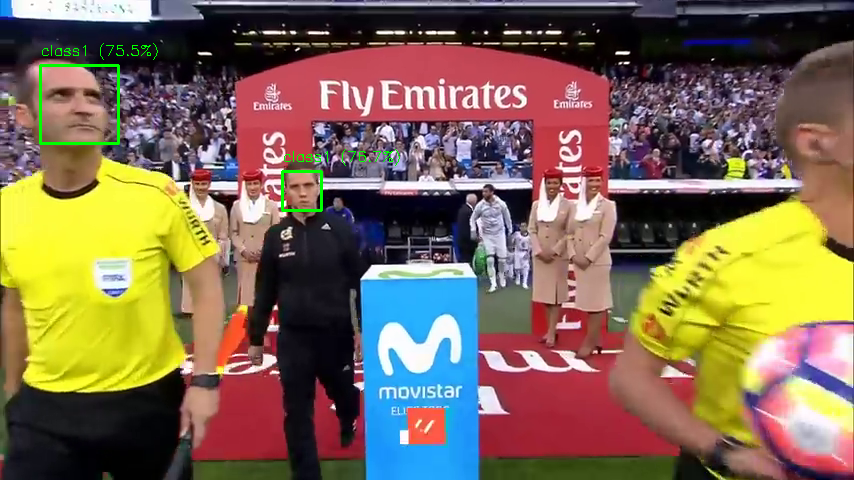

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step


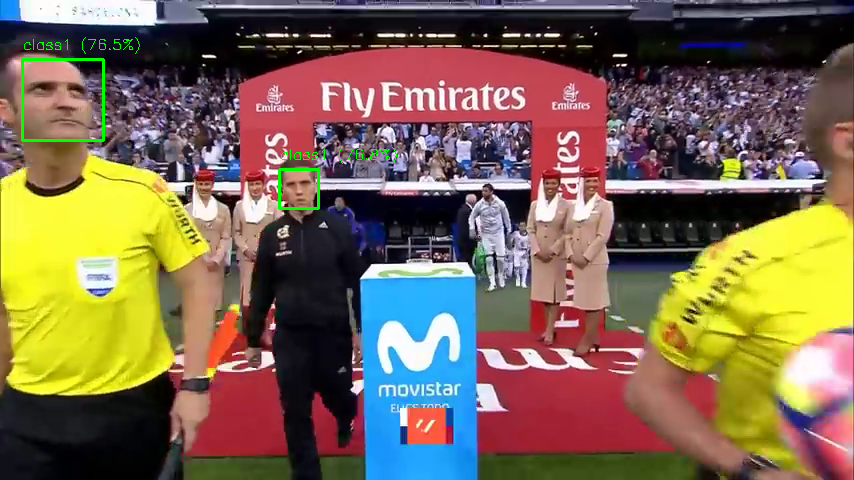

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step


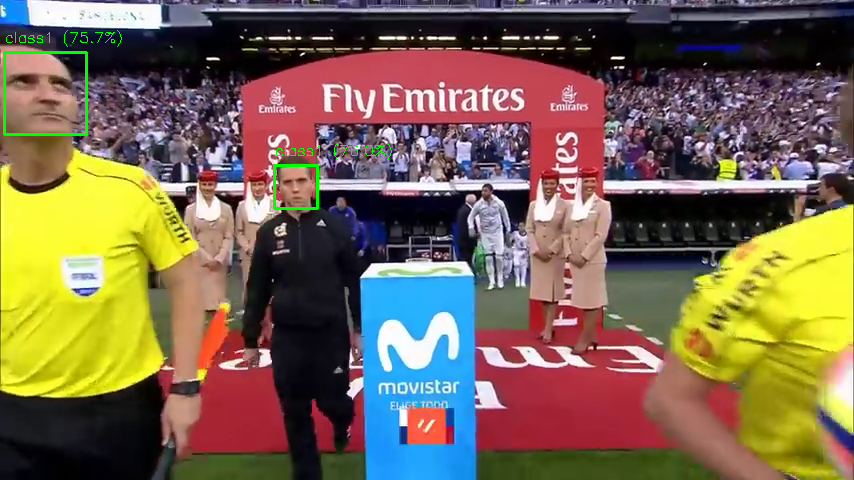

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step


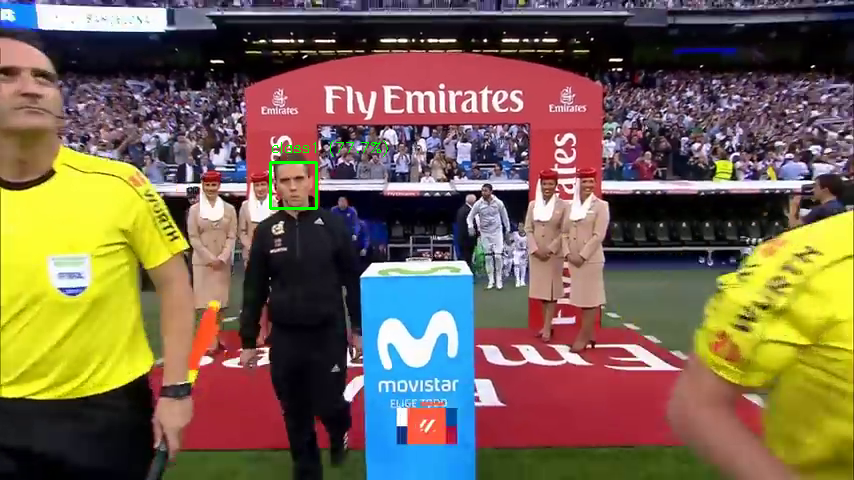

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


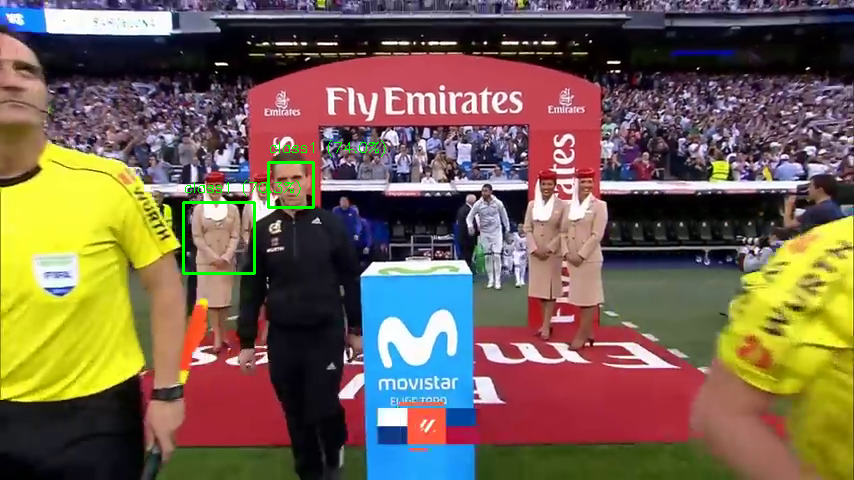

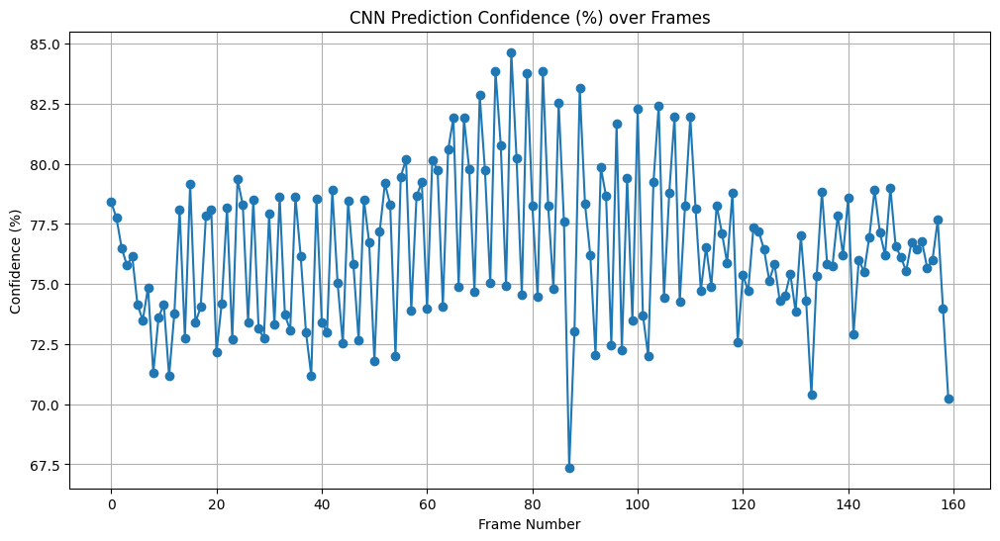

In [ ]:
# =========================================================
# SMART CLASSROOM — VIDEO FACE DETECTION + CNN PREDICTION + ACCURACY GRAPH (CPU-ONLY)
# =========================================================

# STEP 1 — Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# STEP 2 — Import Libraries
import cv2
import numpy as np
import os
import glob
from google.colab.patches import cv2_imshow
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# STEP 3 — Load Classes & CNN Model
BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo2"
classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])
MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"
loaded_model = load_model(MODEL_PATH)
print("Classes:", classes)
print("Model Loaded Successfully!")

# STEP 4 — Predict Single Image + Accuracy
def predict_single_image_with_accuracy(img):
    img_resized = cv2.resize(img, (128,128))
    img_norm = img_resized.astype("float32") / 255.0
    img_input = np.expand_dims(img_norm, axis=0)
    preds = loaded_model.predict(img_input)[0]
    class_id = np.argmax(preds)
    class_name = classes[class_id]
    confidence = preds[class_id] * 100
    return class_name, confidence

# STEP 5 — Load Haar Cascade for Face Detection (CPU-only)
face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# STEP 6 — Analyze Video
def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    frame_count = 0
    all_confidences = []

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5)

        for (x, y, w, h) in faces:
            face_crop = frame[y:y+h, x:x+w]
            try:
                class_name, confidence = predict_single_image_with_accuracy(face_crop)
            except:
                class_name, confidence = "N/A", 0

            all_confidences.append(confidence)

            # Draw rectangle + label
            cv2.rectangle(frame, (x, y), (x+w, y+h), (0,255,0), 2)
            cv2.putText(frame, f"{class_name} ({confidence:.1f}%)",
                        (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,255,0), 1)

        cv2_imshow(frame)
        frame_count += 1

        # Colab safety: limit number of frames to avoid freezing
        if frame_count >= 50:
            break

    cap.release()
    cv2.destroyAllWindows()

    # STEP 7 — Accuracy over frames graph
    if all_confidences:
        plt.figure(figsize=(12,6))
        plt.plot(all_confidences, marker='o')
        plt.title("CNN Prediction Confidence (%) over Frames")
        plt.xlabel("Frame Number")
        plt.ylabel("Confidence (%)")
        plt.grid(True)
        plt.show()
    else:
        print("No faces detected in video.")

# STEP 8 — Run on Video
VIDEO_PATH = "/content/drive/MyDrive/Colab Notebooks/photo2/video/Real Madrid.mp4"
analyze_video(VIDEO_PATH)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Model Loaded Successfully!
Model Input Size: 128
Classes: ['class1', 'class2', 'video']

🔍 Processing video, please wait...

✔ Video Processing Complete!

📸 Showing 5 Sample Predictions:

class1 — 93.79%


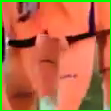

class1 — 65.17%


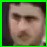

class1 — 70.98%


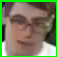

class1 — 65.64%


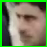

class1 — 60.52%


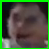

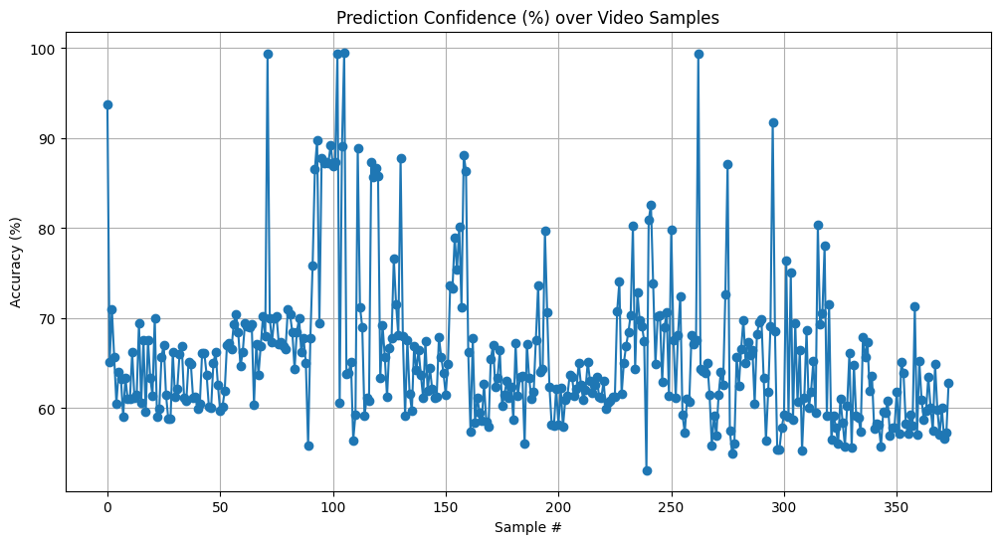

In [ ]:
# ===============================================
# SMART CLASSROOM — FULL VIDEO ANALYSIS + GRAPH
# CPU-ONLY, NO DLIB, NO CUDA ERROR
# ===============================================

# STEP 1 — Mount Drive
from google.colab import drive
drive.mount('/content/drive')

# STEP 2 — Imports
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

# ===============================================
# STEP 3 — Load Model + Classes
# ===============================================

MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"
BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo2"

model = load_model(MODEL_PATH)
print("Model Loaded Successfully!")

# detect input size automatically
model_input_shape = model.input_shape
IMG_SIZE = model_input_shape[1]
print("Model Input Size:", IMG_SIZE)

# load classes
classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])
print("Classes:", classes)

# ===============================================
# STEP 4 — Square Crop Function (Fixes Shape Error)
# ===============================================

def make_square_crop(frame, x, y, w, h):
    size = max(w, h)
    cx = x + w // 2
    cy = y + h // 2

    x1 = max(0, cx - size // 2)
    y1 = max(0, cy - size // 2)
    x2 = x1 + size
    y2 = y1 + size

    return frame[y1:y2, x1:x2]

# ===============================================
# STEP 5 — Predict face
# ===============================================

def predict_face(face_img):
    face_img = cv2.resize(face_img, (IMG_SIZE, IMG_SIZE))
    face_img = face_img.astype("float32") / 255.0
    face_img = np.expand_dims(face_img, axis=0)

    preds = model.predict(face_img, verbose=0)[0]
    class_id = np.argmax(preds)
    accuracy = preds[class_id] * 100

    return classes[class_id], float(accuracy)

# ===============================================
# STEP 6 — Analyze Full Video (sampling every 15 frames)
# ===============================================

def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades
                                         + 'haarcascade_frontalface_default.xml')

    frame_id = 0
    accuracies = []
    sample_images = []
    sample_labels = []

    print("\n🔍 Processing video, please wait...\n")

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Sample every 15 frames
        if frame_id % 15 == 0:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            faces = face_cascade.detectMultiScale(gray, 1.2, 5)

            for (x, y, w, h) in faces:
                face_crop = make_square_crop(frame, x, y, w, h)

                try:
                    label, acc = predict_face(face_crop)
                except:
                    label, acc = "N/A", 0

                accuracies.append(acc)
                sample_images.append(face_crop)
                sample_labels.append(label)

                # Draw on frame
                cv2.rectangle(frame, (x,y), (x+w,y+h), (0,255,0), 2)
                cv2.putText(frame, f"{label} ({acc:.1f}%)",
                            (x, y-10), cv2.FONT_HERSHEY_SIMPLEX,
                            0.6, (0,255,0), 2)

        frame_id += 1

    cap.release()
    print("✔ Video Processing Complete!")

    return sample_images, sample_labels, accuracies

# ===============================================
# STEP 7 — Run the analysis
# ===============================================

VIDEO_PATH = "/content/drive/MyDrive/Colab Notebooks/photo2/video/Barcelona.mp4"

sample_images, sample_labels, accuracies = analyze_video(VIDEO_PATH)

# ===============================================
# STEP 8 — Show Sample Predictions Visually
# ===============================================

print("\n📸 Showing 100 Sample Predictions:\n")

for i in range(min(100, len(sample_images))):
    print(f"{sample_labels[i]} — {accuracies[i]:.2f}%")
    cv2_imshow(sample_images[i])

# ===============================================
# STEP 9 — Accuracy Graph
# ===============================================

if len(accuracies) > 0:
    plt.figure(figsize=(12, 6))
    plt.plot(accuracies, marker="o")
    plt.title("Prediction Confidence (%) over Video Samples")
    plt.xlabel("Sample #")
    plt.ylabel("Accuracy (%)")
    plt.grid(True)
    plt.show()
else:
    print("No faces detected — accuracy graph skipped.")


In [ ]:
import os

path = "/content/drive/MyDrive/Colab Notebooks/"
print(os.listdir(path))


['Untitled0.ipynb', 'Untitled1.ipynb', 'photo', 'photo2', 'ImageDetection.ipynb']


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Model Loaded Successfully!
Model Input Size: 128
Classes: ['class1', 'class2', 'video']

🔍 Processing video, please wait...

✔ Video Processing Complete!

📸 Showing 100 Sample Predictions:

class1 — 93.79%


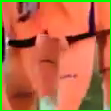

class1 — 65.17%


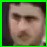

class1 — 70.98%


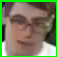

class1 — 65.64%


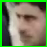

class1 — 60.52%


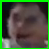

class1 — 64.05%


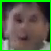

class1 — 63.30%


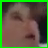

class1 — 59.07%


class1 — 63.41%


class1 — 61.01%


class1 — 61.01%


class1 — 66.19%


class1 — 61.13%


class1 — 61.44%


class1 — 69.47%


class1 — 60.61%


class1 — 67.51%


class1 — 59.57%


class1 — 67.61%


class1 — 63.35%


class1 — 61.43%


class1 — 70.03%


class1 — 59.08%


class1 — 59.96%


class1 — 65.73%


class1 — 67.04%


class1 — 61.48%


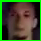

class1 — 58.79%


class1 — 58.82%


class1 — 66.23%


class1 — 61.28%


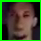

class1 — 62.19%


class1 — 66.04%


class1 — 66.89%


class1 — 61.18%


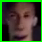

class1 — 60.84%


class1 — 65.16%


class1 — 64.94%


class1 — 61.11%


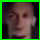

class1 — 61.24%


class1 — 59.96%


class1 — 60.51%


class1 — 66.17%


class1 — 66.11%


class1 — 63.69%


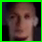

class1 — 60.12%


class1 — 60.08%


class1 — 66.21%


class1 — 65.01%


class1 — 62.56%


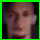

class1 — 59.70%


class1 — 60.12%


class1 — 61.89%


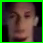

class1 — 66.98%


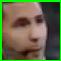

class1 — 67.18%


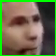

class1 — 66.60%


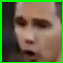

class1 — 69.29%


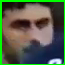

class1 — 70.48%


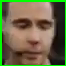

class1 — 68.50%


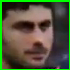

class1 — 64.64%


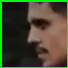

class1 — 66.21%


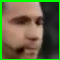

class1 — 69.44%


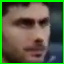

class1 — 69.14%


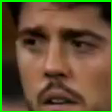

class1 — 69.03%


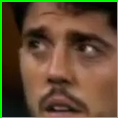

class1 — 69.31%


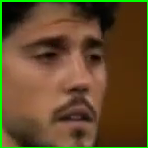

class1 — 60.41%


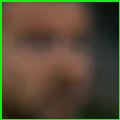

class1 — 67.13%


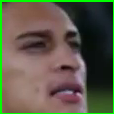

class1 — 63.74%


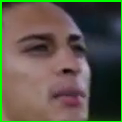

class1 — 66.91%


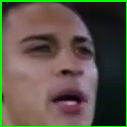

class1 — 70.23%


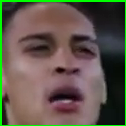

class1 — 68.02%


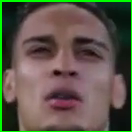

class1 — 99.34%


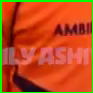

class1 — 70.00%


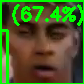

class1 — 67.38%


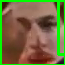

class1 — 69.98%


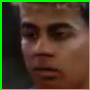

class1 — 70.21%


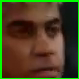

class1 — 67.17%


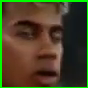

class1 — 67.30%


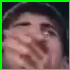

class1 — 66.88%


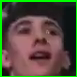

class1 — 66.57%


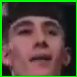

class1 — 70.95%


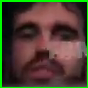

class1 — 70.40%


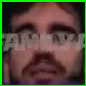

class1 — 68.43%


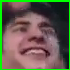

class1 — 64.32%


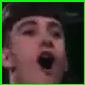

class1 — 68.50%


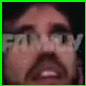

class1 — 69.94%


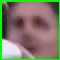

class1 — 66.20%


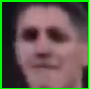

class1 — 67.81%


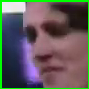

class1 — 64.98%


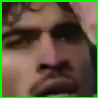

class1 — 55.82%


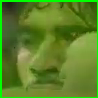

class1 — 67.82%


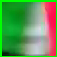

class1 — 75.88%


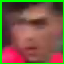

class1 — 86.53%


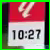

class1 — 89.83%


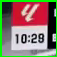

class1 — 69.39%


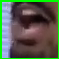

class1 — 87.77%


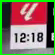

class1 — 87.24%


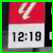

class1 — 87.33%


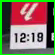

class1 — 87.28%


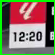

class1 — 89.24%


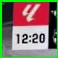

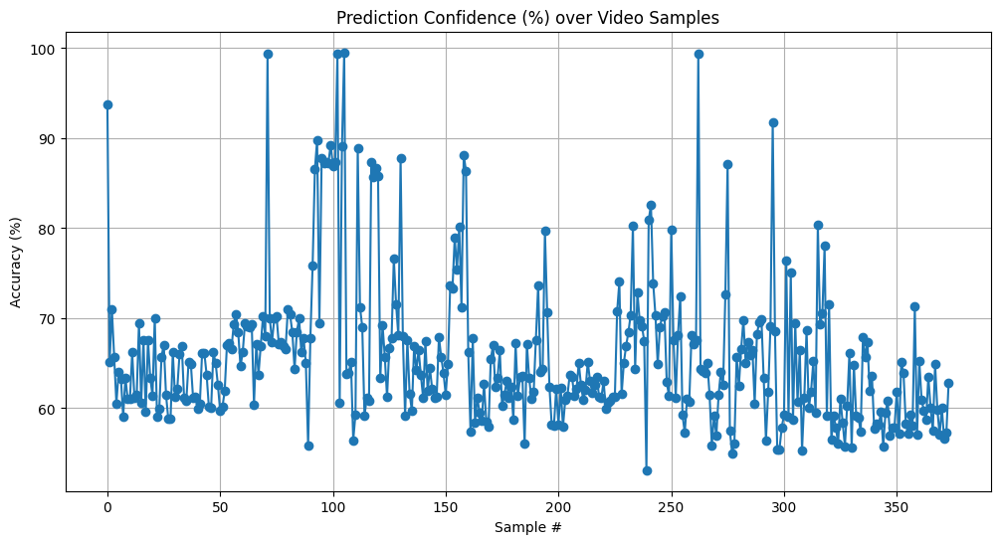

In [ ]:
# ===============================================
# SMART CLASSROOM — FULL VIDEO ANALYSIS + GRAPH
# CPU-ONLY, NO DLIB, NO CUDA ERROR
# ===============================================

# STEP 1 — Mount Drive
from google.colab import drive
drive.mount('/content/drive')

# STEP 2 — Imports
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

# ===============================================
# STEP 3 — Load Model + Classes
# ===============================================

MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"
BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo2"

model = load_model(MODEL_PATH)
print("Model Loaded Successfully!")

# detect input size automatically
model_input_shape = model.input_shape
IMG_SIZE = model_input_shape[1]
print("Model Input Size:", IMG_SIZE)

# load classes
classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])
print("Classes:", classes)

# ===============================================
# STEP 4 — Square Crop Function (Fixes Shape Error)
# ===============================================

def make_square_crop(frame, x, y, w, h):
    size = max(w, h)
    cx = x + w // 2
    cy = y + h // 2

    x1 = max(0, cx - size // 2)
    y1 = max(0, cy - size // 2)
    x2 = x1 + size
    y2 = y1 + size

    return frame[y1:y2, x1:x2]

# ===============================================
# STEP 5 — Predict face
# ===============================================

def predict_face(face_img):
    face_img = cv2.resize(face_img, (IMG_SIZE, IMG_SIZE))
    face_img = face_img.astype("float32") / 255.0
    face_img = np.expand_dims(face_img, axis=0)

    preds = model.predict(face_img, verbose=0)[0]
    class_id = np.argmax(preds)
    accuracy = preds[class_id] * 100

    return classes[class_id], float(accuracy)

# ===============================================
# STEP 6 — Analyze Full Video (sampling every 15 frames)
# ===============================================

def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades
                                         + 'haarcascade_frontalface_default.xml')

    frame_id = 0
    accuracies = []
    sample_images = []
    sample_labels = []

    print("\n🔍 Processing video, please wait...\n")

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Sample every 15 frames
        if frame_id % 15 == 0:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            faces = face_cascade.detectMultiScale(gray, 1.2, 5)

            for (x, y, w, h) in faces:
                face_crop = make_square_crop(frame, x, y, w, h)

                try:
                    label, acc = predict_face(face_crop)
                except:
                    label, acc = "N/A", 0

                accuracies.append(acc)
                sample_images.append(face_crop)
                sample_labels.append(label)

                # Draw on frame
                cv2.rectangle(frame, (x,y), (x+w,y+h), (0,255,0), 2)
                cv2.putText(frame, f"{label} ({acc:.1f}%)",
                            (x, y-10), cv2.FONT_HERSHEY_SIMPLEX,
                            0.6, (0,255,0), 2)

        frame_id += 1

    cap.release()
    print("✔ Video Processing Complete!")

    return sample_images, sample_labels, accuracies

# ===============================================
# STEP 7 — Run the analysis
# ===============================================

VIDEO_PATH = "/content/drive/MyDrive/Colab Notebooks/photo2/video/Barcelona.mp4"

sample_images, sample_labels, accuracies = analyze_video(VIDEO_PATH)

# ===============================================
# STEP 8 — Show Sample Predictions Visually
# ===============================================

print("\n📸 Showing 100 Sample Predictions:\n")

for i in range(min(100, len(sample_images))):
    print(f"{sample_labels[i]} — {accuracies[i]:.2f}%")
    cv2_imshow(sample_images[i])

# ===============================================
# STEP 9 — Accuracy Graph
# ===============================================

if len(accuracies) > 0:
    plt.figure(figsize=(12, 6))
    plt.plot(accuracies, marker="o")
    plt.title("Prediction Confidence (%) over Video Samples")
    plt.xlabel("Sample #")
    plt.ylabel("Accuracy (%)")
    plt.grid(True)
    plt.show()
else:
    print("No faces detected — accuracy graph skipped.")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Model Loaded Successfully!
Model Input Size: 128
Classes: ['class1', 'class2', 'video']

🔍 Processing video, please wait...

✔ Video Processing Complete!

📸 Showing 100 Sample Predictions:

class1 — 79.17%


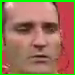

class1 — 77.81%


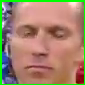

class1 — 72.52%


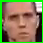

class1 — 79.61%


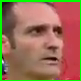

class1 — 79.62%


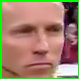

class1 — 72.65%


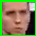

class1 — 75.42%


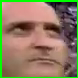

class1 — 77.11%


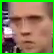

class1 — 74.78%


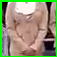

class1 — 74.20%


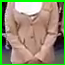

class1 — 73.59%


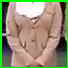

class1 — 72.00%


class1 — 71.07%


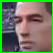

class1 — 69.02%


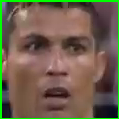

class1 — 66.11%


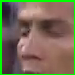

class1 — 62.70%


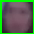

class1 — 78.41%


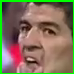

class1 — 61.88%


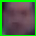

class1 — 62.90%


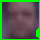

class1 — 62.37%


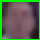

class1 — 66.37%


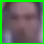

class1 — 58.30%


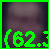

class1 — 62.27%


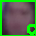

class1 — 79.79%


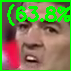

class1 — 62.38%


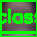

class1 — 63.82%


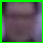

class1 — 67.91%


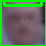

class1 — 62.82%


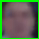

class1 — 65.38%


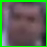

class1 — 59.84%


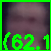

class1 — 62.08%


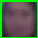

class1 — 74.62%


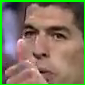

class1 — 62.60%


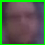

class1 — 65.95%


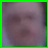

class1 — 66.86%


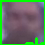

class1 — 62.66%


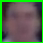

class1 — 66.26%


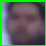

class1 — 58.26%


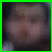

class1 — 61.45%


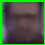

class1 — 61.68%


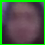

class1 — 56.26%


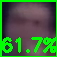

class1 — 72.47%


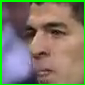

class1 — 62.16%


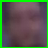

class1 — 65.78%


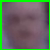

class1 — 66.82%


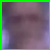

class1 — 65.38%


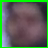

class1 — 59.05%


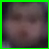

class1 — 70.22%


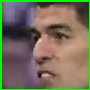

class1 — 62.34%


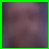

class1 — 66.82%


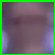

class1 — 60.35%


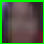

class1 — 65.45%


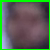

class1 — 61.13%


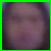

class1 — 68.79%


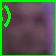

class1 — 62.65%


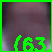

class1 — 63.97%


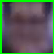

class1 — 63.13%


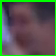

class1 — 66.05%


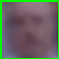

class1 — 62.74%


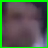

class1 — 61.62%


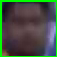

class1 — 63.27%


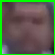

class1 — 66.60%


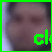

class1 — 65.37%


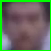

class1 — 64.42%


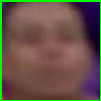

class1 — 61.35%


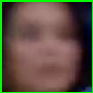

class1 — 66.86%


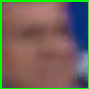

class1 — 62.68%


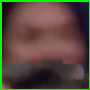

class1 — 66.54%


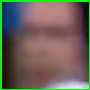

class1 — 61.42%


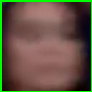

class1 — 67.46%


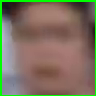

class1 — 64.86%


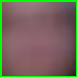

class1 — 67.74%


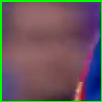

class1 — 60.77%


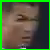

class1 — 70.24%


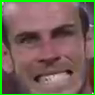

class1 — 58.20%


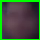

class1 — 58.85%


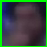

class1 — 57.56%


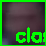

class1 — 59.25%


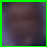

class1 — 58.49%


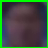

class1 — 58.00%


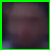

class1 — 65.47%


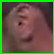

class1 — 55.08%


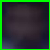

class1 — 57.31%


class1 — 59.19%


class1 — 62.20%


class1 — 61.80%


class1 — 63.13%


class1 — 64.44%


class1 — 64.19%


class1 — 58.71%


class1 — 73.76%


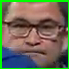

class1 — 59.30%


class1 — 63.29%


class1 — 64.99%


class1 — 60.25%


class1 — 61.98%


class1 — 64.24%


class1 — 65.18%


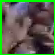

class1 — 70.61%


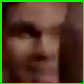

class1 — 69.57%


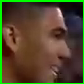

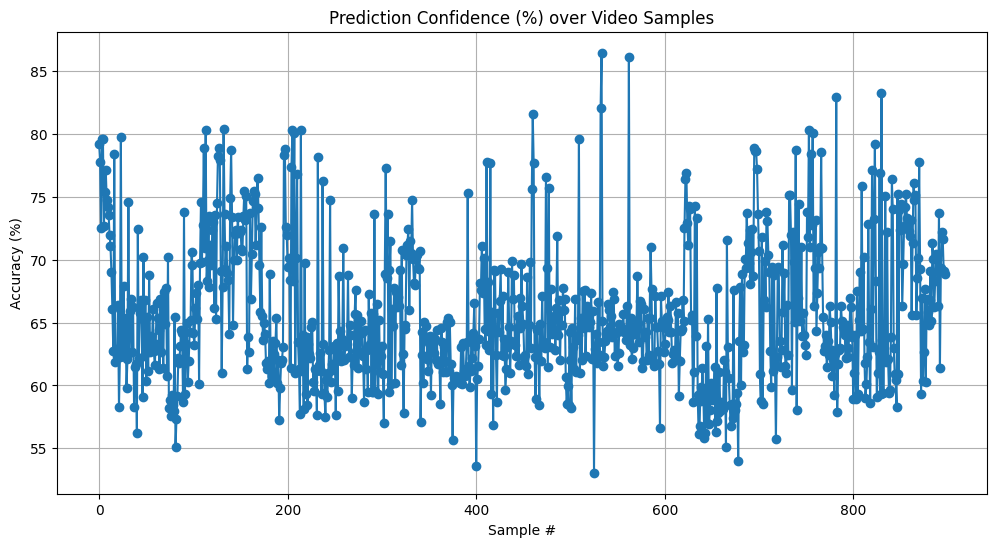

In [ ]:
# ===============================================
# SMART CLASSROOM — FULL VIDEO ANALYSIS + GRAPH
# CPU-ONLY, NO DLIB, NO CUDA ERROR
# ===============================================

# STEP 1 — Mount Drive
from google.colab import drive
drive.mount('/content/drive')

# STEP 2 — Imports
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model

# ===============================================
# STEP 3 — Load Model + Classes
# ===============================================

MODEL_PATH = "/content/drive/MyDrive/smart_classroom_cnn_model.h5"
BASE_FOLDER = "/content/drive/MyDrive/Colab Notebooks/photo2"

model = load_model(MODEL_PATH)
print("Model Loaded Successfully!")

# detect input size automatically
model_input_shape = model.input_shape
IMG_SIZE = model_input_shape[1]
print("Model Input Size:", IMG_SIZE)

# load classes
classes = sorted([d for d in os.listdir(BASE_FOLDER) if os.path.isdir(os.path.join(BASE_FOLDER, d))])
print("Classes:", classes)

# ===============================================
# STEP 4 — Square Crop Function (Fixes Shape Error)
# ===============================================

def make_square_crop(frame, x, y, w, h):
    size = max(w, h)
    cx = x + w // 2
    cy = y + h // 2

    x1 = max(0, cx - size // 2)
    y1 = max(0, cy - size // 2)
    x2 = x1 + size
    y2 = y1 + size

    return frame[y1:y2, x1:x2]

# ===============================================
# STEP 5 — Predict face
# ===============================================

def predict_face(face_img):
    face_img = cv2.resize(face_img, (IMG_SIZE, IMG_SIZE))
    face_img = face_img.astype("float32") / 255.0
    face_img = np.expand_dims(face_img, axis=0)

    preds = model.predict(face_img, verbose=0)[0]
    class_id = np.argmax(preds)
    accuracy = preds[class_id] * 100

    return classes[class_id], float(accuracy)

# ===============================================
# STEP 6 — Analyze Full Video (sampling every 15 frames)
# ===============================================

def analyze_video(video_path):
    cap = cv2.VideoCapture(video_path)
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades
                                         + 'haarcascade_frontalface_default.xml')

    frame_id = 0
    accuracies = []
    sample_images = []
    sample_labels = []

    print("\n🔍 Processing video, please wait...\n")

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        # Sample every 15 frames
        if frame_id % 15 == 0:
            gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            faces = face_cascade.detectMultiScale(gray, 1.2, 5)

            for (x, y, w, h) in faces:
                face_crop = make_square_crop(frame, x, y, w, h)

                try:
                    label, acc = predict_face(face_crop)
                except:
                    label, acc = "N/A", 0

                accuracies.append(acc)
                sample_images.append(face_crop)
                sample_labels.append(label)

                # Draw on frame
                cv2.rectangle(frame, (x,y), (x+w,y+h), (0,255,0), 2)
                cv2.putText(frame, f"{label} ({acc:.1f}%)",
                            (x, y-10), cv2.FONT_HERSHEY_SIMPLEX,
                            0.6, (0,255,0), 2)

        frame_id += 1

    cap.release()
    print("✔ Video Processing Complete!")

    return sample_images, sample_labels, accuracies

# ===============================================
# STEP 7 — Run the analysis
# ===============================================

VIDEO_PATH = "/content/drive/MyDrive/Colab Notebooks/photo2/video/Real Madrid.mp4"

sample_images, sample_labels, accuracies = analyze_video(VIDEO_PATH)

# ===============================================
# STEP 8 — Show Sample Predictions Visually
# ===============================================

print("\n📸 Showing 100 Sample Predictions:\n")

for i in range(min(100, len(sample_images))):
    print(f"{sample_labels[i]} — {accuracies[i]:.2f}%")
    cv2_imshow(sample_images[i])

# ===============================================
# STEP 9 — Accuracy Graph
# ===============================================

if len(accuracies) > 0:
    plt.figure(figsize=(12, 6))
    plt.plot(accuracies, marker="o")
    plt.title("Prediction Confidence (%) over Video Samples")
    plt.xlabel("Sample #")
    plt.ylabel("Accuracy (%)")
    plt.grid(True)
    plt.show()
else:
    print("No faces detected — accuracy graph skipped.")
